In [1]:
# Import Packages
import glob
import cv2
import math
import pickle
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
from ipywidgets import interact, interactive, fixed

%matplotlib inline

In [2]:

def display_images(image_grid, grayscale_colormap=None, color_colormap=None, columns=2):
    """
    grayscale_colormap: A string representing the grayscale color map for 2D shaped images
    color_colormap: A string representing the color map for 3D shaped images
    columns: An integer specifying the number of columns for presenting images
    :return: None
    """
    length = len(image_grid)
    no_of_rows = math.ceil(length / columns)

    fig, axs = plt.subplots(no_of_rows, columns, figsize=(columns * 5, no_of_rows * 5))
    axs = axs.ravel()

    selected_colormaps = [grayscale_colormap if len(image.shape) == 2 else color_colormap for image in image_grid]
    for ax, image, cmap in zip(axs, image_grid, selected_colormaps):
        ax.imshow(image, cmap=cmap)
        ax.axis('off')

    for unused_ax in axs[len(image_grid):]:
        unused_ax.axis('off')


    plt.show()


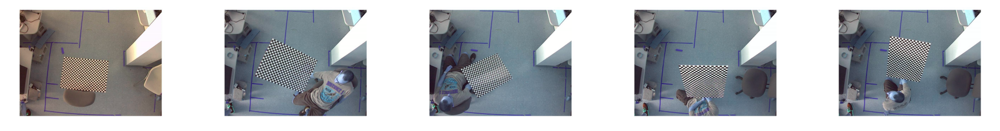

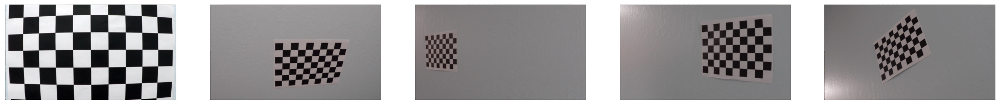

In [3]:
# Loading test images from test_image directory
caliberated_images = []
for path in glob.glob("chess_board_images/*"):
    img = cv2.imread(path)
    caliberated_images.append(img)

caliberated_images_with_noise = []
for path in glob.glob("Sample_Calibration_Images/*"):
    img = cv2.imread(path)
    caliberated_images_with_noise.append(img)
# Visualize calibration images
display_images(caliberated_images_with_noise[:5], columns=5)
display_images(caliberated_images[:5], columns=5)


In [4]:
# Create object points with x, y, and z coordinates as zeros for chessboard corners
global_object_points = np.zeros((54, 3), np.float32)

# Set the first two columns of object points with coordinates of inner chessboard corners
global_object_points[:,:2] = np.mgrid[0:9, 0:6].T.reshape(-1,2)

global_obj_points_list = []
global_img_points_list = []

# Function to detect and visualize chessboard corners on an image
def detect_and_visualize_chessboard(image_input, grid_size=(9, 6)):
    cnv = cv2.cvtColor(image_input, cv2.COLOR_BGR2GRAY)
    
    # Detect chessboard corners on the grayscale image
    detection_status, detected_corners = cv2.findChessboardCorners(cnv, grid_size, None)
    
    # If chessboard corners are detected, store object points and image points
    if detection_status:
        global_obj_points_list.append(global_object_points)
        global_img_points_list.append(detected_corners)
        cv2.drawChessboardCorners(image_input, grid_size, detected_corners, detection_status)
    
    # Return the input image with detected corners drawn
    return image_input




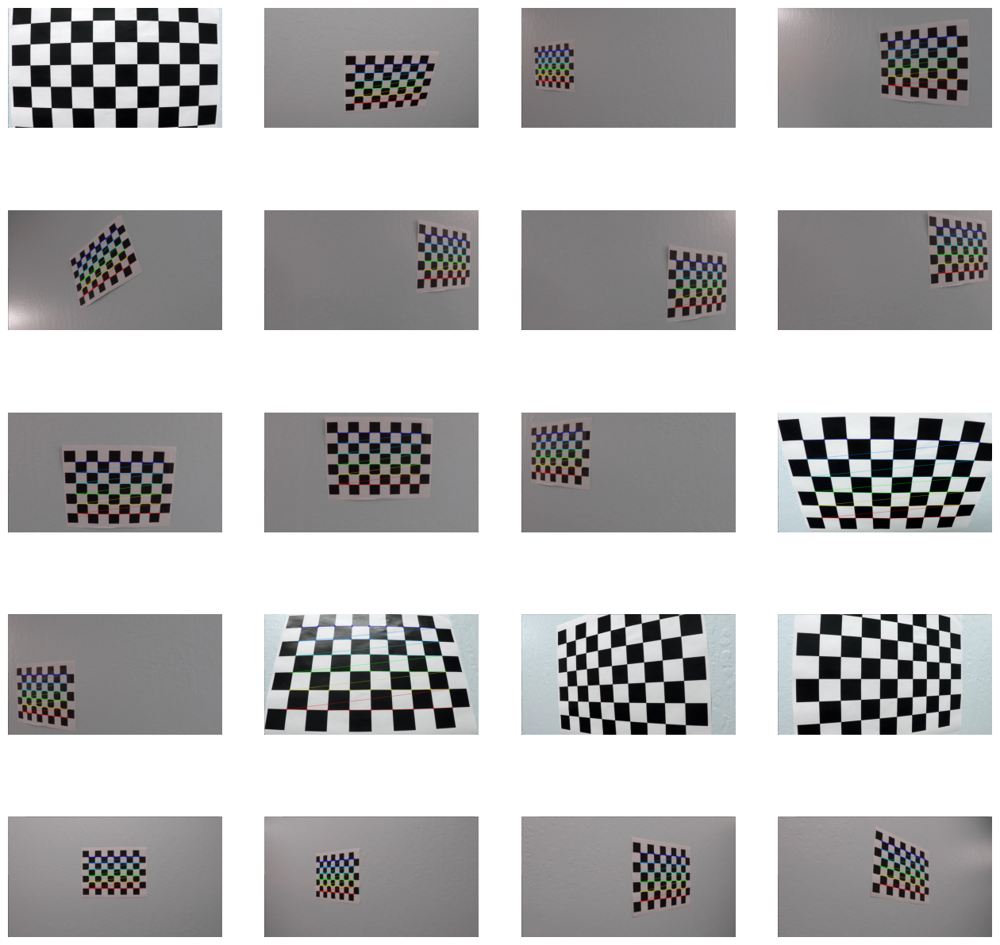

In [5]:
def visualize_chessboard_detections(image_list, detection_function, grid_size=(9, 6)):
    # Calculate the number of rows and columns for the subplots based on the number of input images
    no_of_imgs = len(image_list)
    no_of_columns = 4
    no_of_rows = (no_of_imgs + no_of_columns - 1) // no_of_columns
    # Create a figure with subplots and set the figure size
    fig, axs = plt.subplots(no_of_rows, no_of_columns, figsize=(16, 16))
    axs = axs.ravel()
    for iter, input in enumerate(image_list):
        # Apply the chessboard detection function to the current image
        res_img = detection_function(input, grid_size)

        # Display the result image in the current subplot
        axs[iter].axis('off')
        axs[iter].imshow(res_img)

        # Hide any unused subplots
        for i in range(iter + 1, no_of_rows * no_of_columns):
            axs[i].axis('off')


    # Show the figure with the subplots
    plt.show()

# Use the visualization function with the list of input images and the detection function
visualize_chessboard_detections(caliberated_images, detect_and_visualize_chessboard)


In [6]:

chess_board_sample = mpimg.imread("chess_board_images/calibration1.jpg")
img_size = chess_board_sample.shape[:2]

# calculating caliberation matrix
# camera_matrix - camera calibrated matrix
# distortion_params - distortion cofficients
calibration_status, camera_matrix, distortion_params, rotation_vectors, translation_vectors = cv2.calibrateCamera(global_obj_points_list, global_img_points_list,img_size, None, None)
# Save the Camera calibration results for later use
dist_pickle = {"camera_matrix": camera_matrix, "dist": distortion_params}
pickle.dump( dist_pickle, open( "resources/calibration.p", "wb" ) )

In [7]:
def correct_distortion(input_image):
    """
    This function corrects the distortion in images using the camera calibration matrix and distortion coefficients.
    input_image - The input image to be corrected
    :return - The corrected (undistorted) image
    """
    corrected_image = cv2.undistort(input_image, camera_matrix, distortion_params, None, camera_matrix)
    return corrected_image


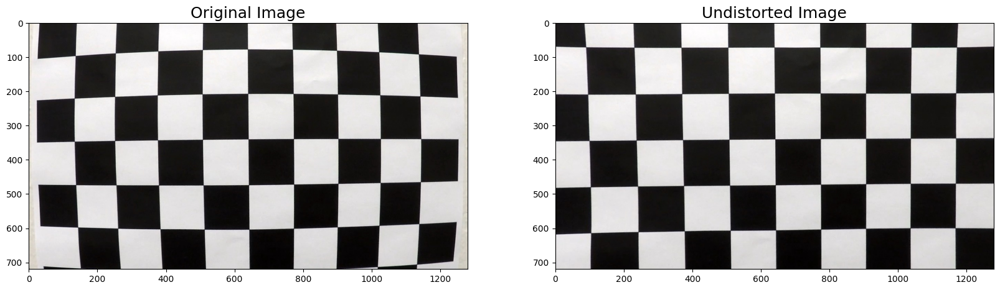

In [8]:
def compare_original_and_corrected(input_image):
    """
    This function visualizes the distortion-corrected image alongside the original image.
    
    input_image: The input image to be corrected
    :return: The corrected (undistorted) image
    """
    corrected_image = correct_distortion(input_image)
    plot, (HR, VR) = plt.subplots(1, 2, figsize=(20, 20))
    HR.imshow(input_image)
    HR.set_title('Original Image', fontsize=18)
    VR.imshow(corrected_image)
    VR.set_title('Undistorted Image', fontsize=18)
    
    return corrected_image

result = compare_original_and_corrected(chess_board_sample)


In [9]:
def compare_original_and_corrected_road(image):
    # Define the chessboard dimensions and square size in meters.
    chessboard_dimensions = (9, 6)
    square_size_meters = 0.0238

    # Define the number of inner corners of the chessboard.
    num_corners_in_chessboard = (chessboard_dimensions[0] - 1, chessboard_dimensions[1] - 1)

    # Generate the chessboard calibration pattern.
    calibration_pattern = np.zeros((np.prod(num_corners_in_chessboard), 3), dtype=np.float32)
    calibration_pattern[:, :2] = np.indices(num_corners_in_chessboard).T.reshape(-1, 2)
    calibration_pattern *= square_size_meters

    # Convert the image to 8-bit grayscale.
    grayscale_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    grayscale_image_8bit = cv2.convertScaleAbs(grayscale_image)

    # Detect the corners of the chessboard in the image.
    calibration_status, corners = cv2.findChessboardCorners(grayscale_image_8bit, num_corners_in_chessboard)

    # If the corners were detected, undistort the image and display it.
    if calibration_status:
        undistorted_image = cv2.undistort(image, camera_matrix, distortion_params, None, camera_matrix)
        cv2.imshow("Original", image)
        cv2.imshow("Undistorted", undistorted_image)
        cv2.waitKey(0)
        cv2.destroyAllWindows()

        # Return the undistorted image and camera matrix.
        return undistorted_image, camera_matrix
    else:
        # If the corners were not detected, return the original image and None for the camera matrix.
        return image, None

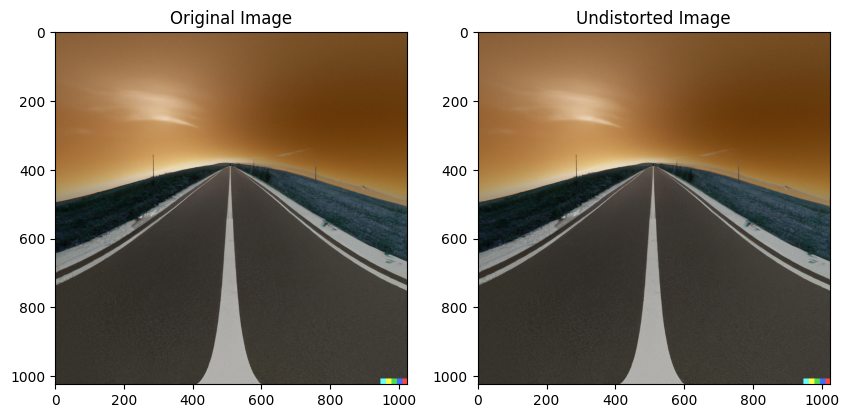

In [10]:
road_distorted = mpimg.imread("distorted_sample/d3.PNG")

res = compare_original_and_corrected_road(road_distorted)
fig, (axes1, axes2) = plt.subplots(1, 2, figsize=(10, 5))
axes1.imshow(cv2.cvtColor(road_distorted, cv2.COLOR_BGR2RGB))
axes1.set_title("Original Image")
axes2.imshow(cv2.cvtColor(res[0], cv2.COLOR_BGR2RGB))
axes2.set_title("Undistorted Image")
plt.show()

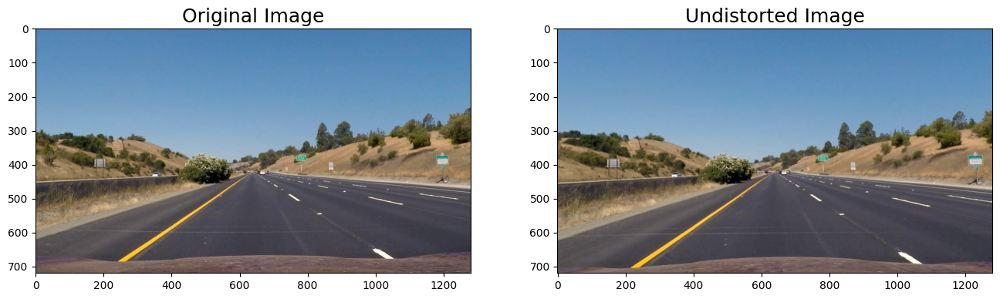

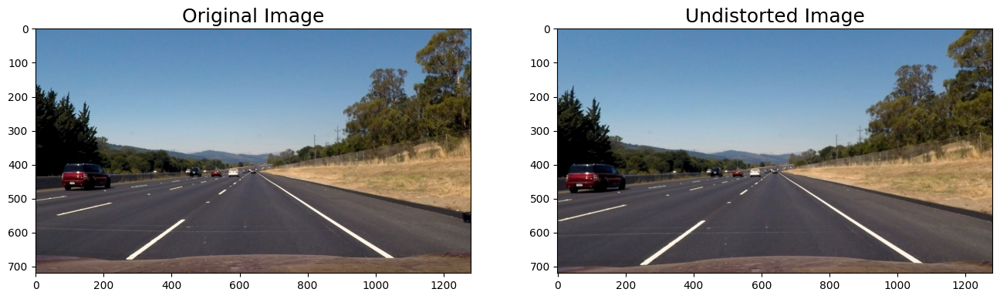

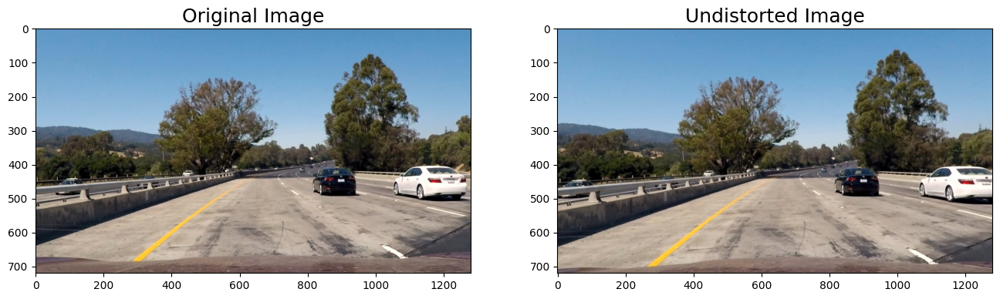

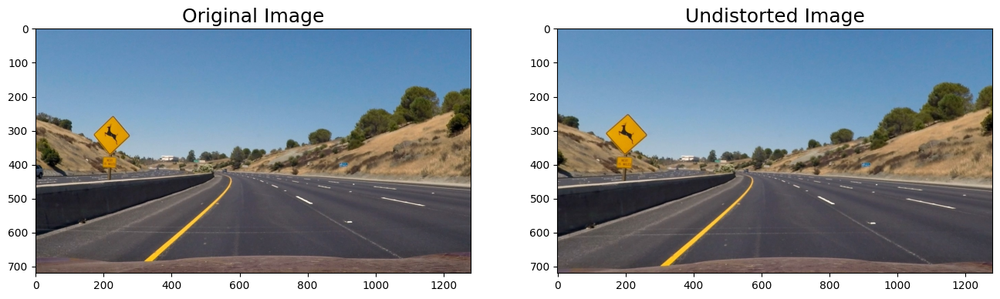

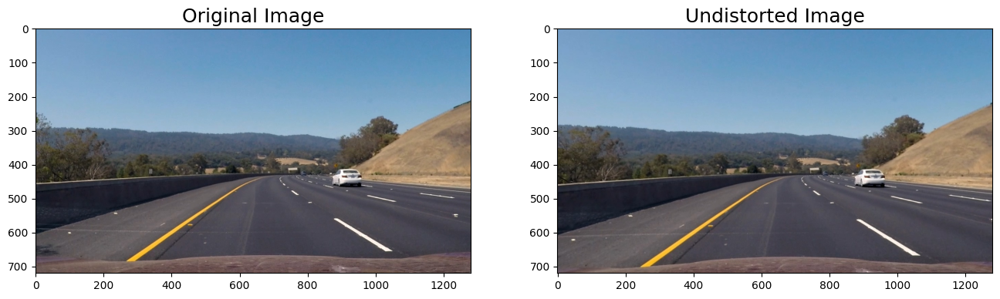

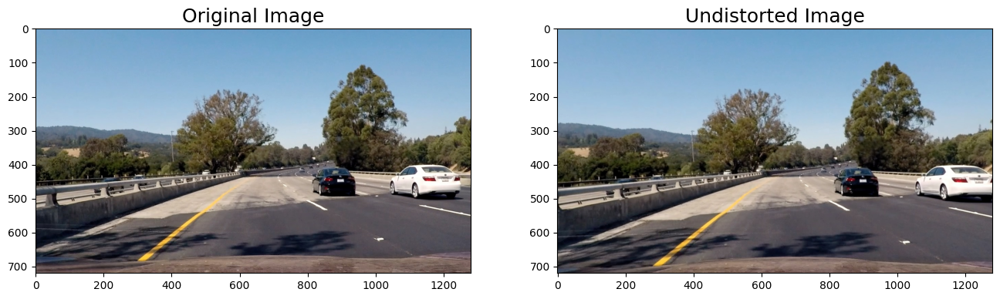

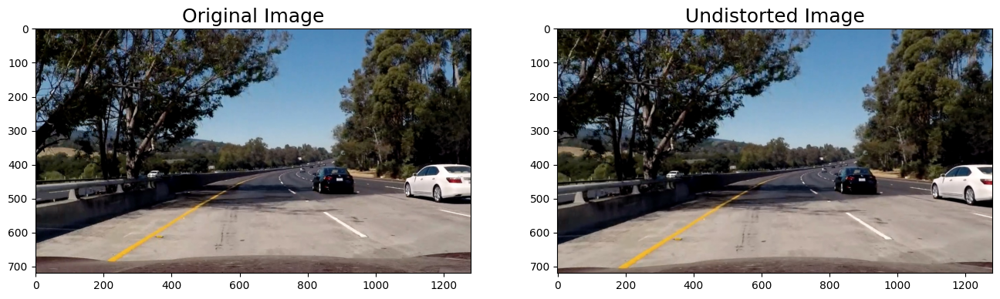

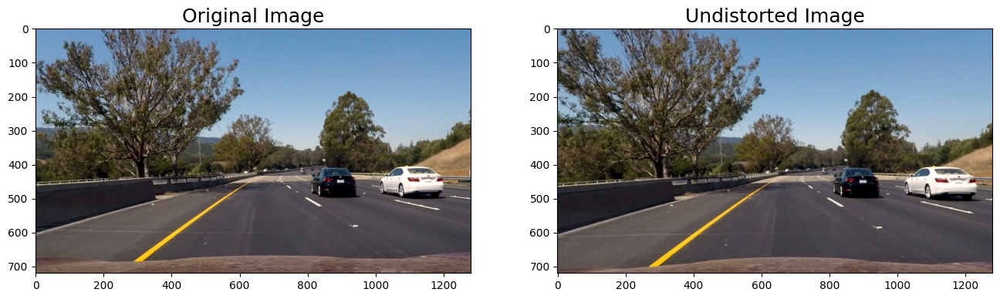

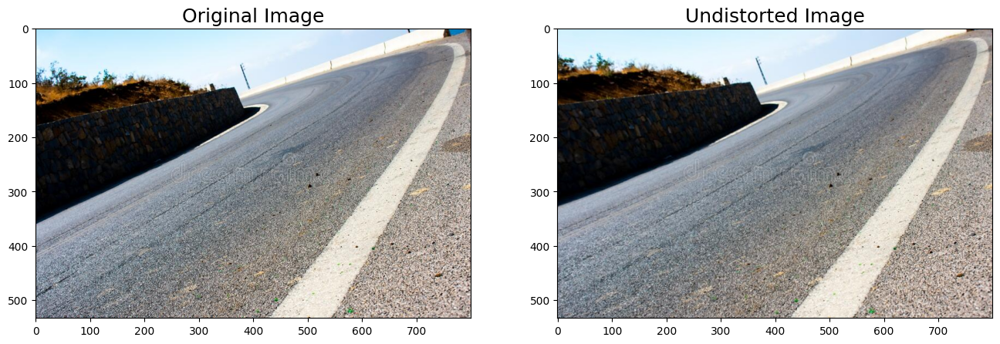

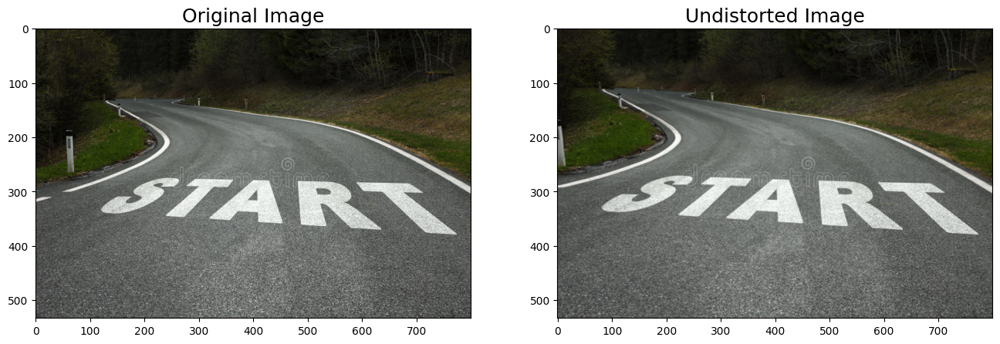

In [11]:
test_images=[mpimg.imread(path) for path in glob.glob("test_images/*")]

# Undistort images
undistorted_images = list(map(lambda img: correct_distortion(img), test_images[:10]))
# Loop through the test_images and undistorted_images lists and display the original and undistorted images side by side
for original_img, undistorted_img in zip(test_images[:10], undistorted_images):
    fig, (axes1, axes2) = plt.subplots(1, 2, figsize=(16, 16))
    axes1.imshow(original_img)
    axes1.set_title('Original Image', fontsize=18)
    axes2.imshow(undistorted_img)
    axes2.set_title('Undistorted Image', fontsize=18)
    plt.show()


In [12]:
height, width = test_images[0].shape[:2]

# The source and destination points are chosen by visually inspecting the image and selecting coordinates of interest.
# You can use an image viewer or an image editing tool that shows the mouse pointer coordinates to select these points.
# OpenCV's cv2.imshow() function can also be used to display the image and obtain the coordinates.


init_point1=(575, 465)
init_point2=(705, 465)
init_point3=(255, 685)
init_point4=(1050, 685)
line_color=(255, 0, 0) # Red


dest_point1=(450, 0)
dest_point2=(width-450, 0)
dest_point3=(450, height)
dest_point4=(width-450, height)


In [13]:
def draw_polygon_on_image(input_image, line_color=(0, 0,255)):
    """
    Drawing sample polygon a image
    """
    cv2.line(input_image, init_point1, init_point2, line_color, 3)
    cv2.line(input_image, init_point2, init_point4, line_color, 3)
    cv2.line(input_image, init_point4, init_point3, line_color, 3)
    cv2.line(input_image, init_point3, init_point1, line_color, 3)

    return  input_image

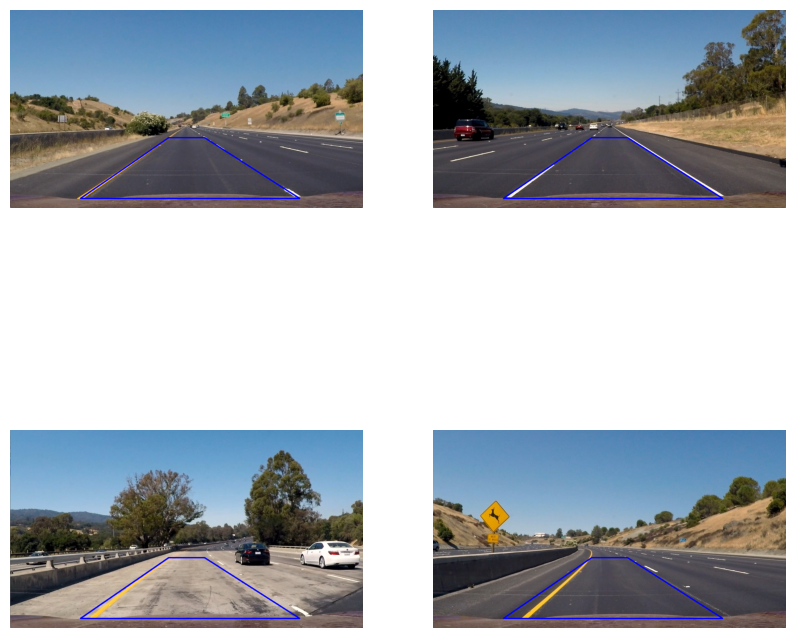

In [14]:
# Draw polygons on test images
# As can be observed, the selected points are suitable only for straight lanes. To account for curved lanes,
# the perspective transformation points must be calculated dynamically during runtime.
src_selected_images = list(map(lambda img: draw_polygon_on_image(img), test_images))
display_images(src_selected_images[:4])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


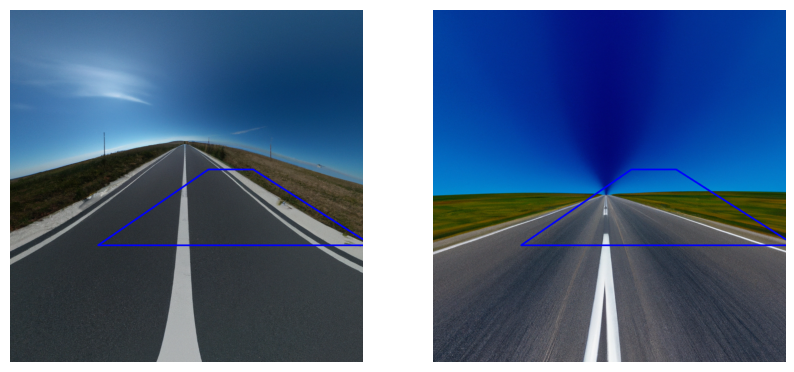

In [15]:
# Draw polygons on test images
# As can be observed, the selected points are suitable only for straight lanes. To account for curved lanes,
# the perspective transformation points must be calculated dynamically during runtime.
images_on_line = [mpimg.imread(path) for path in glob.glob("distorted_sample/*")]

# Undistort images
undistorted_image = list(map(lambda img: correct_distortion(img), images_on_line[:]))# Draw polygons on test images
# In order to detect the lanes accurately, we need to fit a curve to the detected lane lines, especially when the lane curves or switches.
# This is because a straight polygon does not accurately represent the shape of the lane, and can result in incorrect lane detection.
# Loop through the test_images and undistorted_images lists and display the original and undistorted images side by side

src_selected_images = list(map(lambda img: draw_polygon_on_image(img), undistorted_image))
display_images(src_selected_images[:])

In [16]:
# define source and destination points for tranform
src = np.float32([init_point1, init_point2, init_point3, init_point4])
dst = np.float32([dest_point1, dest_point2, dest_point3, dest_point4])

def apply_perspective_transform(input_image, source_points=src, destination_points=dst):
    """
    This function applies a perspective transform to the given distortion-corrected image,
    resulting in a bird's-eye view of the selected region.

    :param input_image: Distortion-corrected image
    :param source_points: Source points for the perspective transformation
    :param destination_points: Destination points for the perspective transformation
    :return: Warped image, transform matrix, and inverse transform matrix
    """
    image_height, image_width = input_image.shape[:2]

    # Use cv2.getPerspectiveTransform() to obtain the transform matrix (M) and its inverse (Minv)
    transformation = cv2.getPerspectiveTransform(source_points, destination_points)
    inverse = cv2.getPerspectiveTransform(destination_points, source_points)

    # Use cv2.warpPerspective() to apply the perspective transformation, resulting in a top-down view
    final_image = cv2.warpPerspective(input_image, transformation, (image_width, image_height), flags=cv2.INTER_LINEAR)

    return final_image, transformation, inverse


In [17]:
def display_unwarped_images(input_image):
    """
    This utility function visualizes both the distortion-corrected image and the unwarped image.

    input_image: A distortion-corrected image
    :return: Unwarped image that can be reused
    """
    # Apply perspective transform to the input image
    after_unwrap, x, t = apply_perspective_transform(input_image)
    figure, (axes1, axes2) = plt.subplots(1, 2, figsize=(16, 16))
    input_image = draw_polygon_on_image(input_image)
    axes1.imshow(input_image)
    axes1.set_title('Distortion-Corrected Image')
    axes2.imshow(after_unwrap)
    axes2.set_title('Unwarped Image')
    return after_unwrap


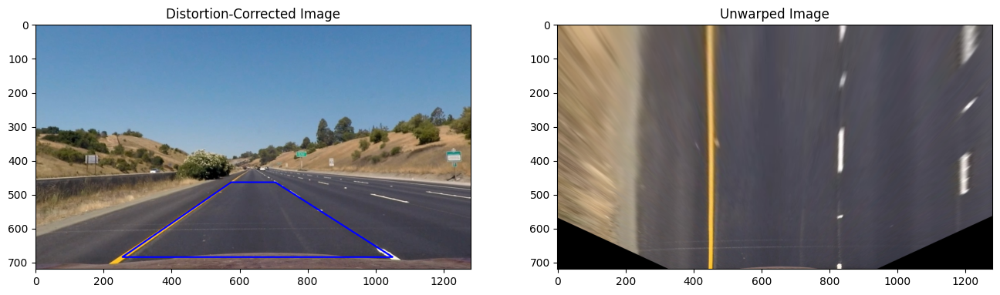

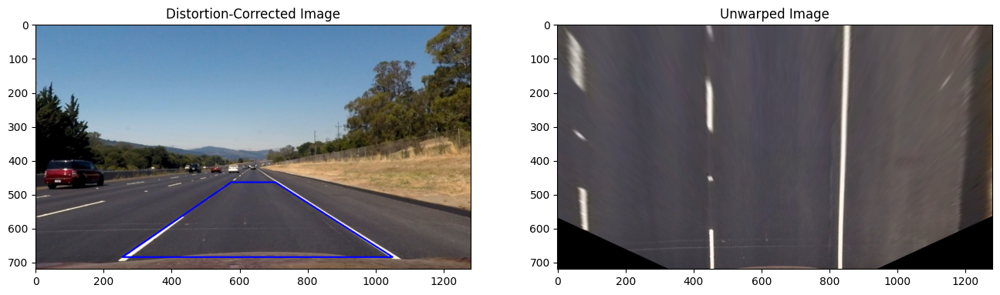

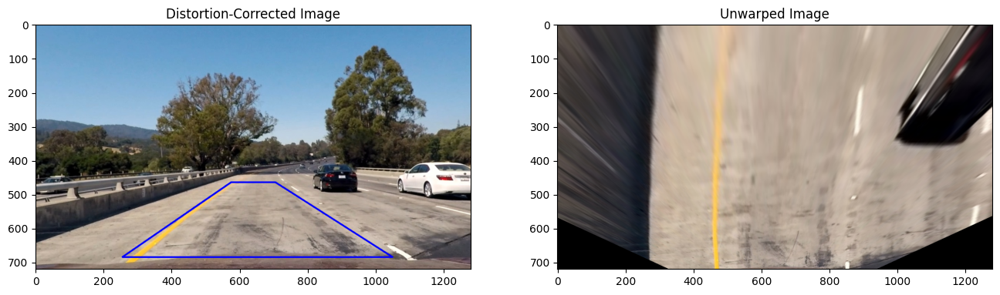

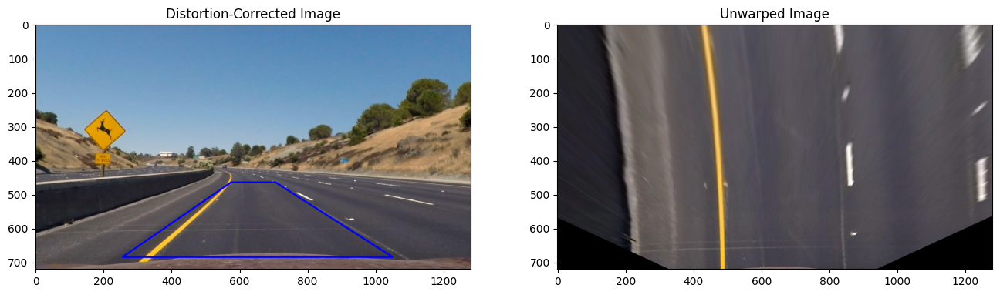

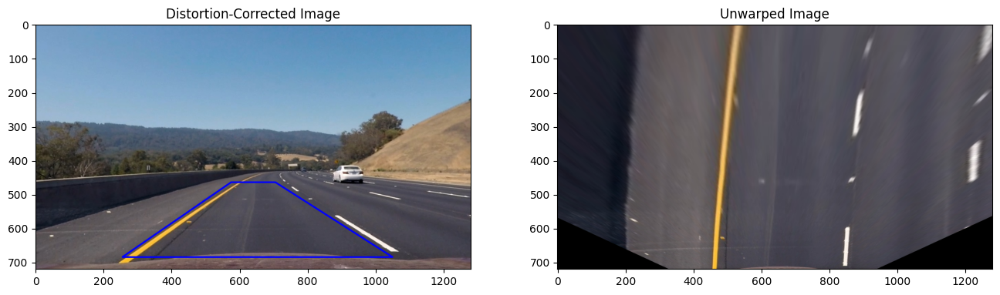

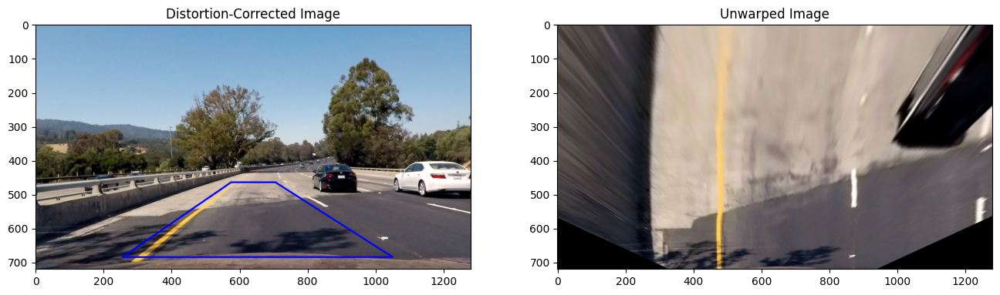

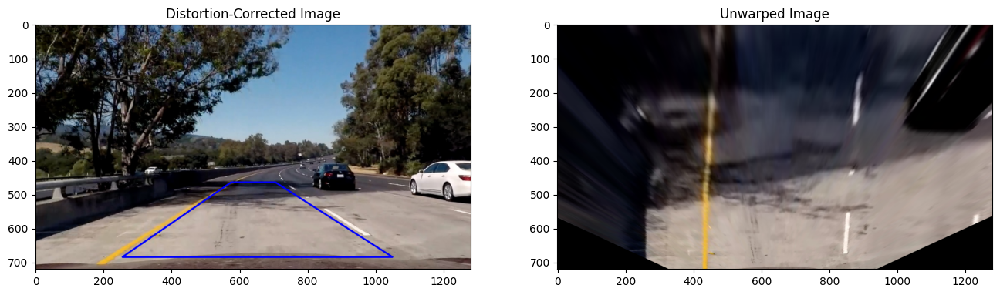

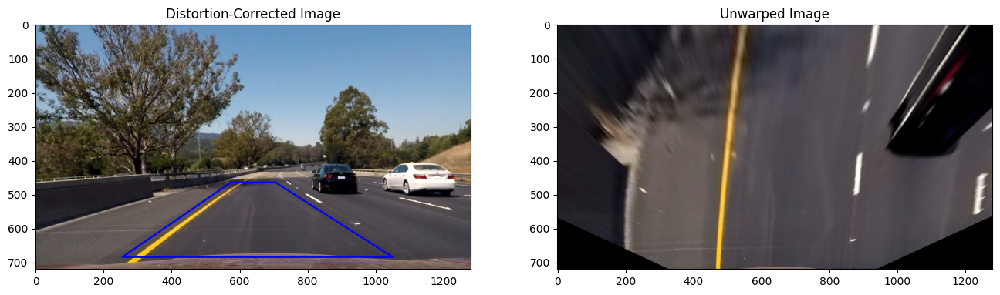

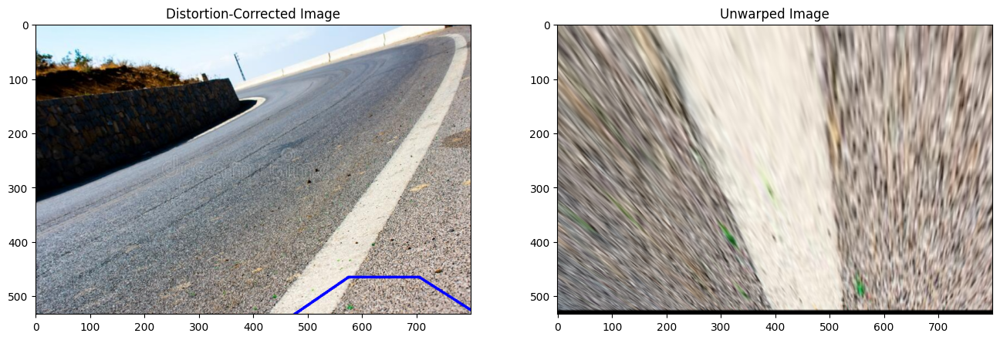

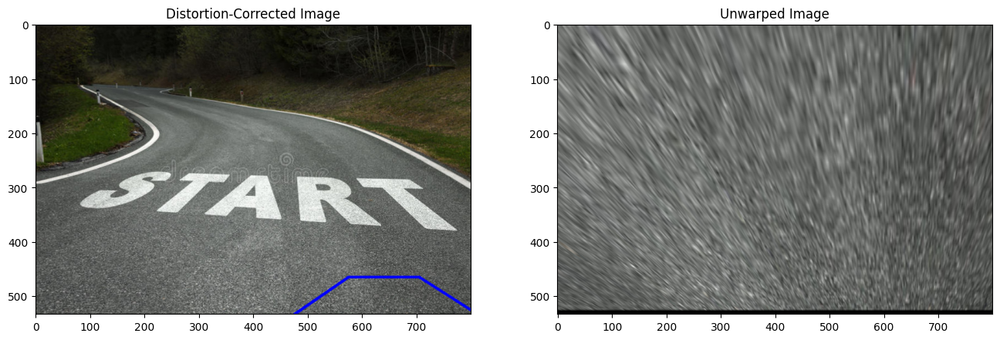

In [18]:
# Apply unwarp to get perspectives from test images
warped_images = list(map(lambda img: display_unwarped_images(img), undistorted_images))

In [19]:
def get_rgb_channels(image):
    """
    RETURNS RGB image.
    """
    R = image[:, :, 0]
    G = image[:, :, 1]
    B = image[:, :, 2]

    return R, G, B

def get_hls_channels(image):
    """
    Extract H, L, and S color channels from an HLS image.
    """
    hls_image = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    hue_channel = hls_image[:, :, 0]
    lightness_channel = hls_image[:, :, 1]
    saturation_channel = hls_image[:, :, 2]

    return hue_channel, lightness_channel, saturation_channel


def extract_lab_channels(image):
    """
    Extract L, A, and B color channels from an LAB image.
    """
    lab_image = cv2.cvtColor(image, cv2.COLOR_RGB2Lab)
    lightness_channel = lab_image[:, :, 0]
    a_channel = lab_image[:, :, 1]
    b_channel = lab_image[:, :, 2]

    return lightness_channel, a_channel, b_channel


In [20]:
def visualize_rgb_channels(image):
    """
    Visualize R, G, and B color channels of an RGB image.
    """
    red_channel, green_channel, blue_channel = get_rgb_channels(image)
    
    fig, axes = plt.subplots(1, 4, figsize=(20, 20))
    axes = axes.ravel()
    
    axes[0].imshow(image)
    axes[0].set_title('Original')
    
    axes[1].imshow(red_channel, cmap='gray')
    axes[1].set_title('RED-channel')
    
    axes[2].imshow(green_channel, cmap='gray')
    axes[2].set_title('GREEN-channel')
    
    axes[3].imshow(blue_channel, cmap='gray')
    axes[3].set_title('BLUE-channel')


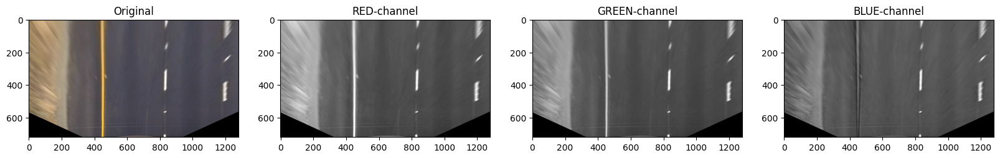

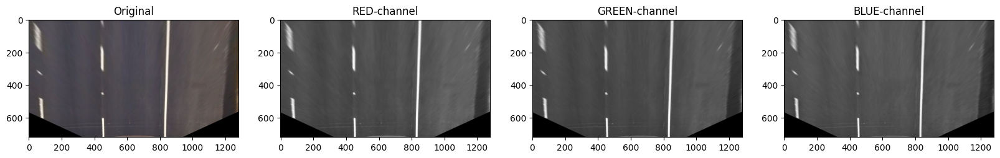

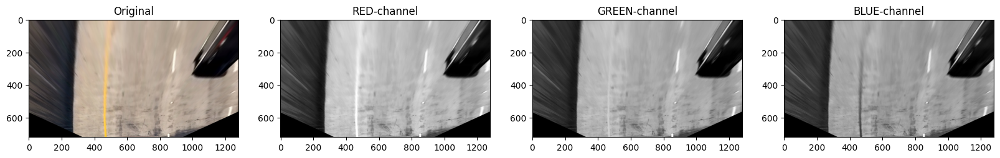

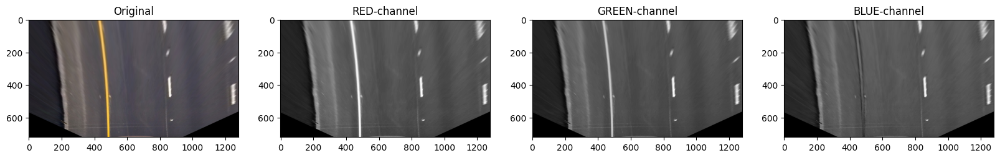

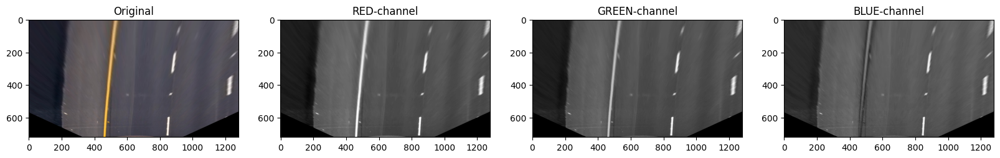

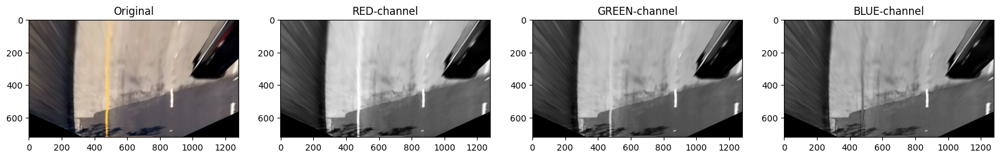

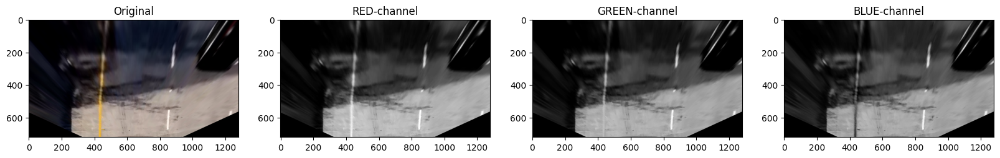

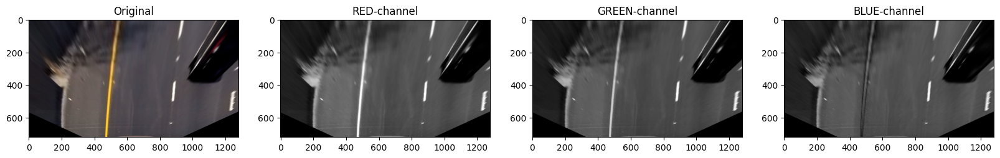

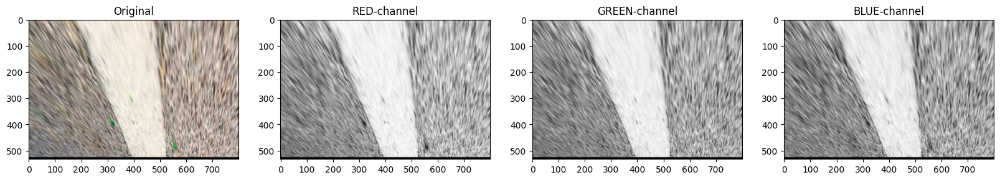

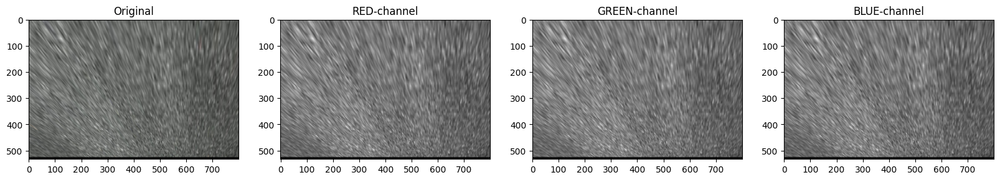

In [21]:
for i in range(len(warped_images)):
    chess_board_sample_test = warped_images[i]
    visualize_rgb_channels(chess_board_sample_test)

In [22]:
def sobel_absolute_threshold(grayscale_image, x_direction=True, minimum_threshold=0, maximum_threshold=255):
    """
    This function applies the Sobel operator to a grayscale image to create a binary image.

    Args:
        grayscale_image (numpy.ndarray): The grayscale image to be processed.
        x_direction (bool, optional): Whether to apply the Sobel operator in the x-direction or y-direction. Defaults to True.
        minimum_threshold (int, optional): The minimum value for the binary threshold. Defaults to 0.
        maximum_threshold (int, optional): The maximum value for the binary threshold. Defaults to 255.

    Returns:
        numpy.ndarray: The binary image.
    """

    # Check the input arguments.
    if not isinstance(grayscale_image, np.ndarray):
        raise TypeError("grayscale_image must be a numpy.ndarray.")
    if not isinstance(x_direction, bool):
        raise TypeError("x_direction must be a boolean.")
    if not isinstance(minimum_threshold, int):
        raise TypeError("minimum_threshold must be an integer.")
    if not isinstance(maximum_threshold, int):
        raise TypeError("maximum_threshold must be an integer.")

    # Apply the Sobel operator.
    if x_direction:
        dx = 1
        dy = 0
    else:
        dx = 0
        dy = 1

    sobel_image = cv2.Sobel(grayscale_image, cv2.CV_64F, dx, dy)
    absolute_image = np.absolute(sobel_image)
    scaled_sobel_image = np.uint8(255 * absolute_image / np.max(absolute_image))

    # Create a mask of 1's where the scaled gradient magnitude is > thresh_min and < thresh_max.
    binary_sobel_image = np.zeros_like(scaled_sobel_image)
    binary_sobel_image[(scaled_sobel_image >= minimum_threshold) & (scaled_sobel_image <= maximum_threshold)] = 1

    return binary_sobel_image

In [23]:

def apply_sobel_threshold_and_display(input_img, grayscale_img, lower_thresh, upper_thresh):
    """
    This function applies edge detection using Sobel thresholds to a grayscale image and displays the results.
    
    :param input_img: Original image
    :param grayscale_img: Grayscale version of the input image
    :param lower_thresh: Lower threshold for binary mask
    :param upper_thresh: Upper threshold for binary mask
    """
    
    # Create a subplot with three axes
    fig, axes = plt.subplots(1, 3, figsize=(16, 16))
    
    # Show the original input image
    axes[0].imshow(input_img)
    axes[0].set_title('Input Image', fontsize=12)
    
    # Apply Sobel threshold in X direction and show the result
    edge_detection_x = sobel_absolute_threshold(grayscale_img, x_direction=True, minimum_threshold=lower_thresh, maximum_threshold=upper_thresh)
    axes[1].imshow(edge_detection_x, cmap='gray')
    axes[1].set_title('Edge Detection - X', fontsize=12)
    
    # Apply Sobel threshold in Y direction and show the result
    edge_detection_y = sobel_absolute_threshold(grayscale_img, x_direction=False, minimum_threshold=lower_thresh, maximum_threshold=upper_thresh)
    axes[2].imshow(edge_detection_y, cmap='gray')
    axes[2].set_title('Edge Detection - Y', fontsize=12)
    
    # Display the subplots
    plt.show()
sobel_min_threshold=50
sobel_max_threshold=190

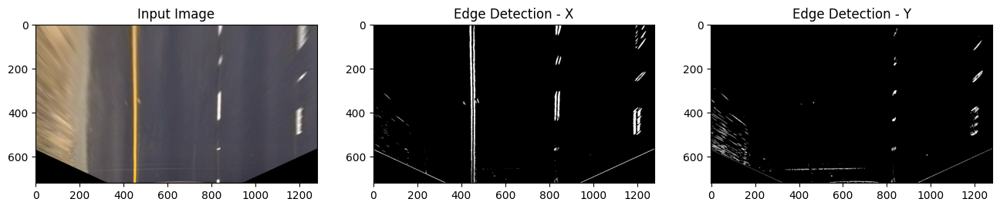

In [24]:
# Get the first warped image from a list of warped images
unwarped_img = warped_images[0]

# Extract the S channel from the HSL color space of the unwarped image
hue, gray, saturation = get_hls_channels(unwarped_img)

# Set minimum and maximum threshold values for the Sobel operator
sobel_min_threshold = 20
sobel_max_threshold = 100

# Apply Sobel threshold to the unwarped image and display the results
apply_sobel_threshold_and_display(unwarped_img, gray, sobel_min_threshold, sobel_max_threshold)


In [25]:
def gradient_magnitude_threshold(gray_image, kernel_size=3, magnitude_threshold=(0, 255)):
    """This function applies the Sobel x and y operators to a grayscale image, 
    computes the gradient magnitude, and returns a binary image.
    
    :param gray_image: Grayscale image
    :param kernel_size: Sobel kernel size (default is 3)
    :param magnitude_threshold: Threshold values for gradient magnitude (default is (0, 255))
    :return: Binary image
    """
    # Apply Sobel x and y operators
    sobel_operator_x = cv2.Sobel(gray_image, cv2.CV_64F, 1, 0, ksize=kernel_size)
    sobel_operator_y = cv2.Sobel(gray_image, cv2.CV_64F, 0, 1, ksize=kernel_size)
    
    # Compute gradient magnitude
    gradient_magnitude = np.sqrt(sobel_operator_x ** 2 + sobel_operator_y ** 2)
    
    # Scale to 8-bit (0 - 255) and convert to uint8
    scaled_gradient_magnitude = np.uint8(255 * gradient_magnitude / np.max(gradient_magnitude))
    
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output_image = np.zeros_like(scaled_gradient_magnitude)
    binary_output_image[(scaled_gradient_magnitude >= magnitude_threshold[0]) & (scaled_gradient_magnitude <= magnitude_threshold[1])] = 1
    
    return binary_output_image



In [26]:
def apply_gradient_magnitude_visualization(original_image, grayscale_image, kernel_size, min_threshold, max_threshold):
    """
    This is a utility function to visualize a Sobel magnitude image.
    
    :param original_image: Unwarped image
    :param grayscale_image: Grayscale version of the input image
    :param kernel_size: Sobel kernel size
    :param min_threshold: Minimum threshold for Sobel magnitude
    :param max_threshold: Maximum threshold for Sobel magnitude
    """
    sobel_magnitude = gradient_magnitude_threshold(grayscale_image, kernel_size, (min_threshold, max_threshold))
    
    fig, (axis1, axis2) = plt.subplots(1, 2, figsize=(16, 16))
    axis1.imshow(original_image)
    axis1.set_title('Original Image', fontsize=18)
    axis2.imshow(sobel_magnitude, cmap='gray')
    axis2.set_title('Sobel Magnitude', fontsize=18)


In [27]:
# Sobel magnitude params
# Min threshold
sobel_min_threshold=50
# Max threshold
sobel_max_threshold=190
# Sobel kernal
sobel_kernel = 15

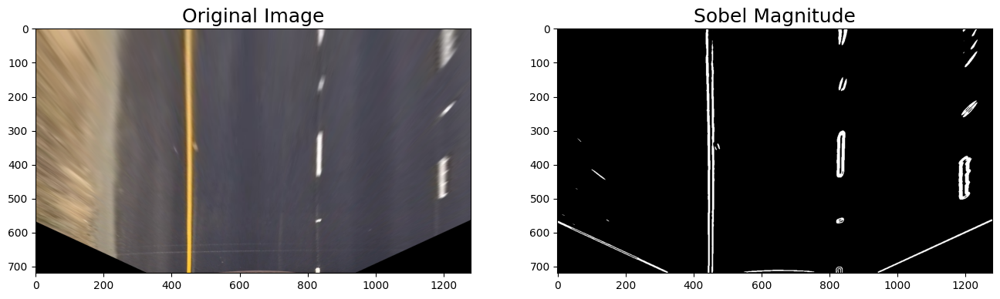

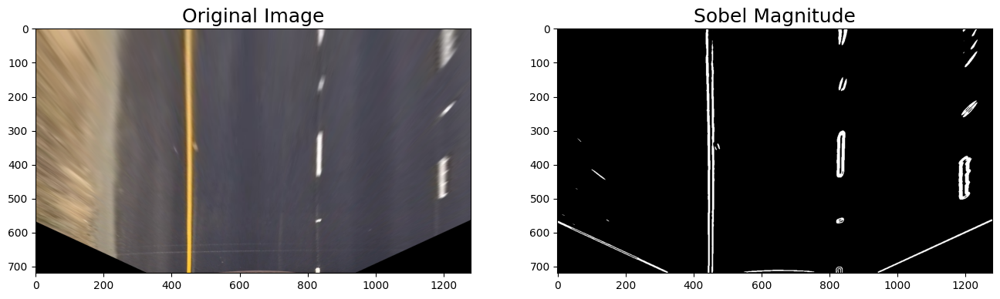

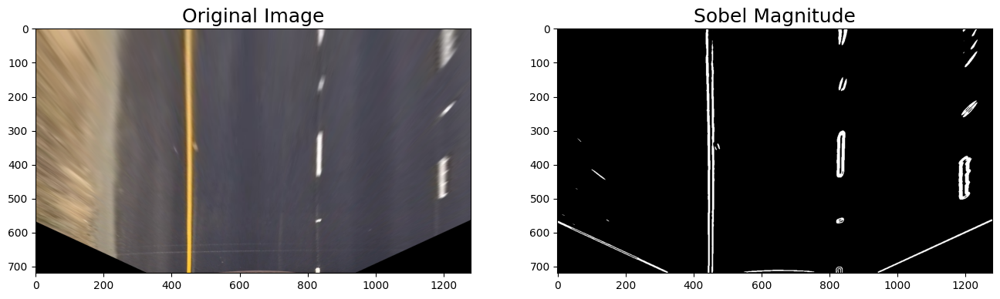

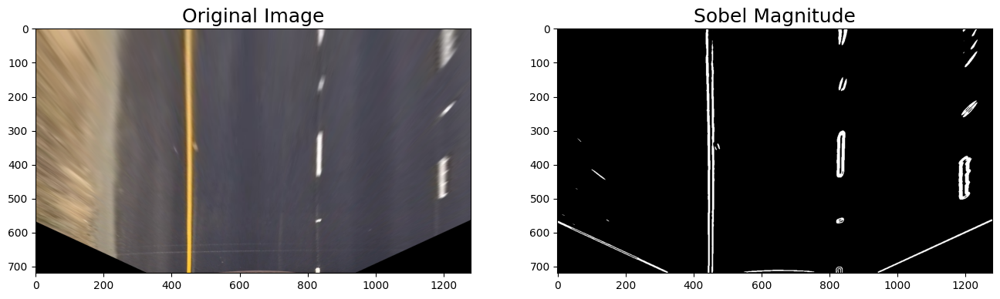

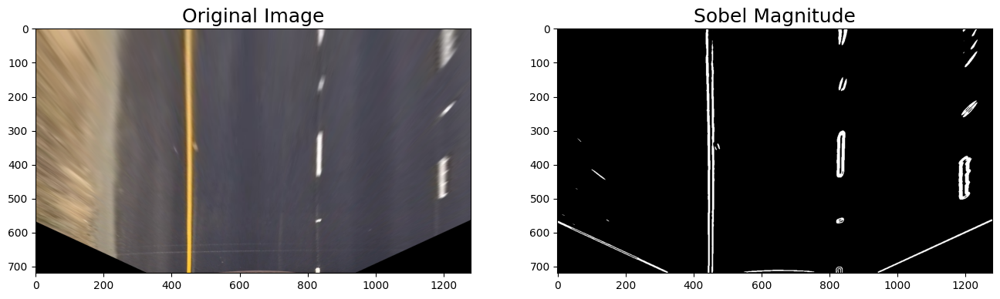

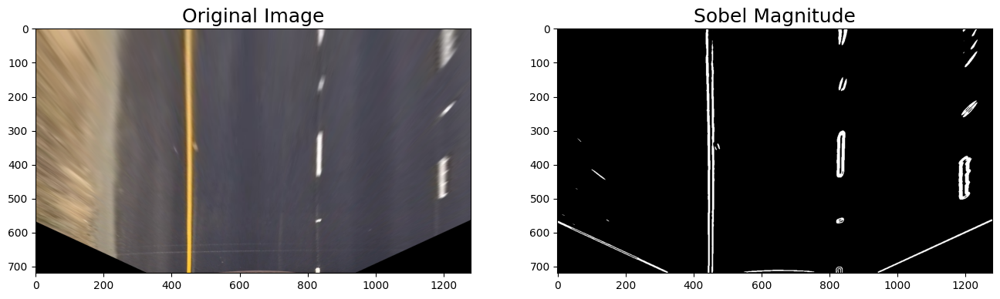

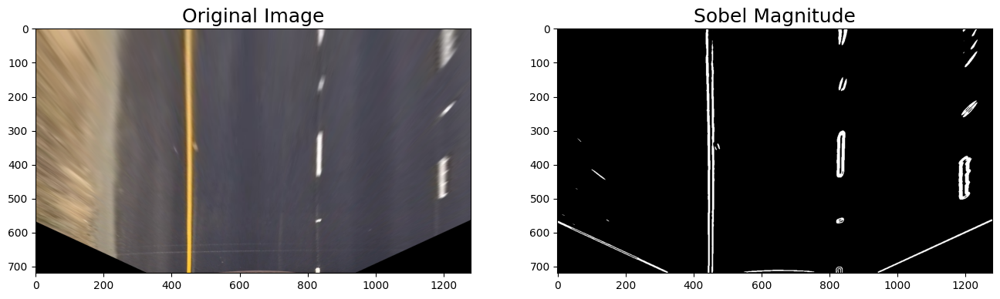

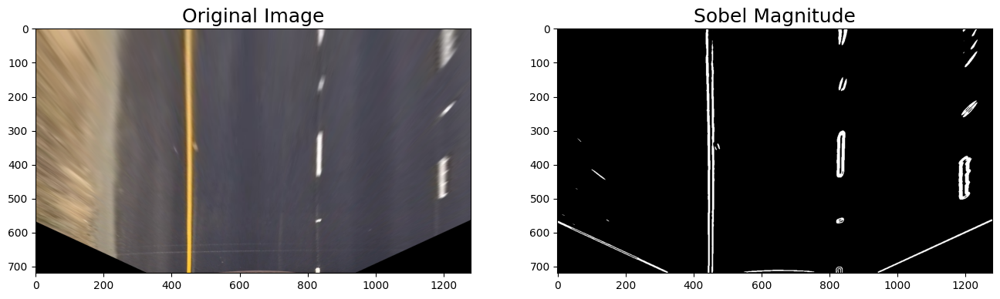

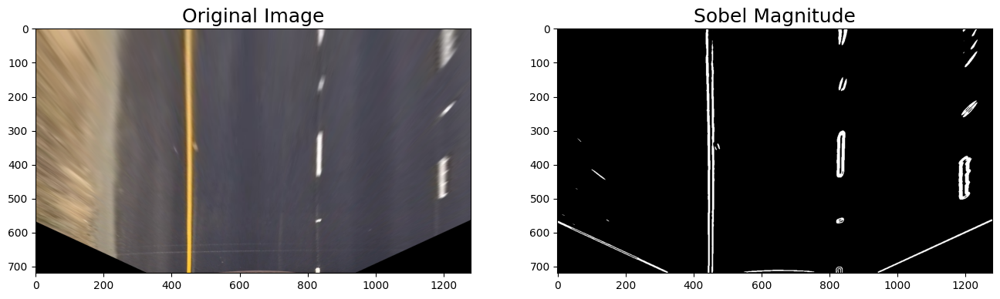

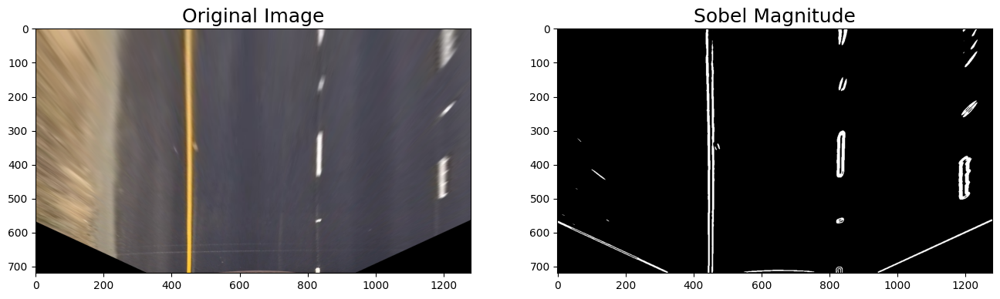

In [28]:
for i in range(len(warped_images)):
    corrected_img = warped_images[i]
    h, gray, l = get_hls_channels(unwarped_img)
    apply_gradient_magnitude_visualization(unwarped_img, gray, sobel_kernel, sobel_min_threshold, sobel_max_threshold)


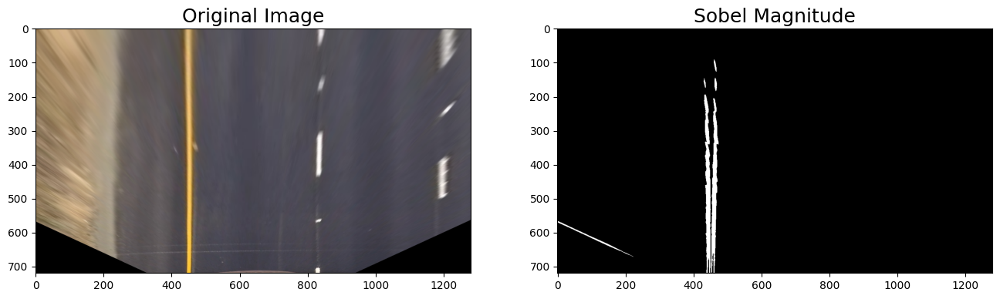

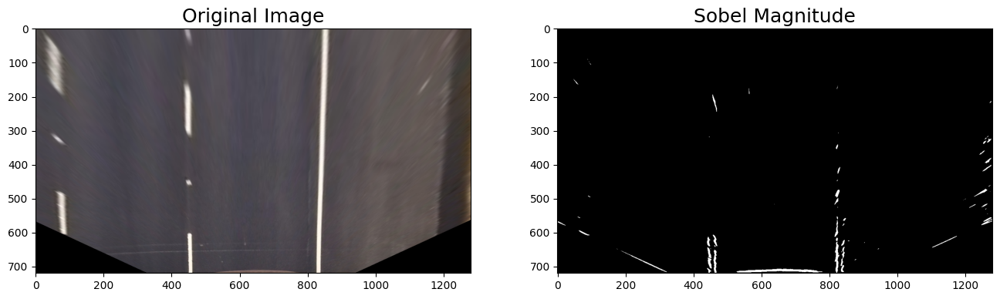

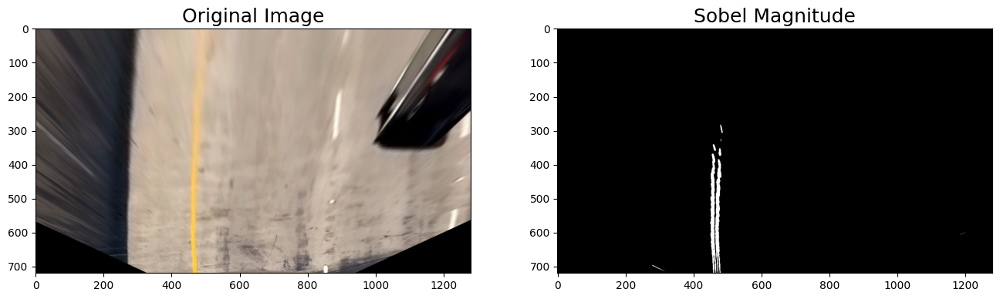

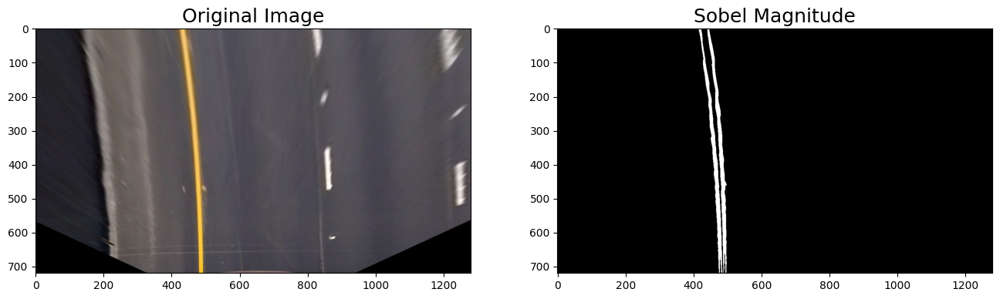

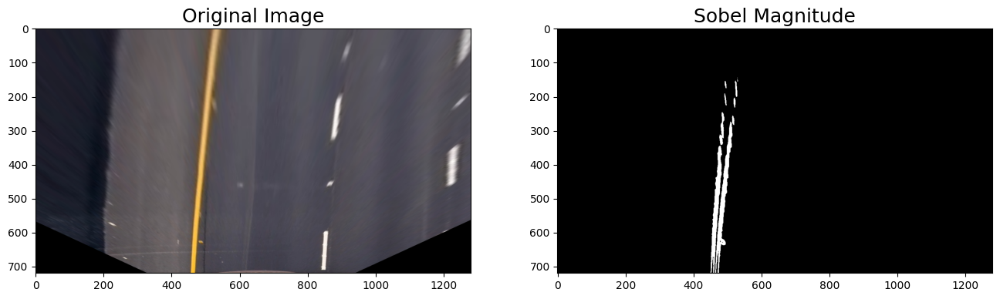

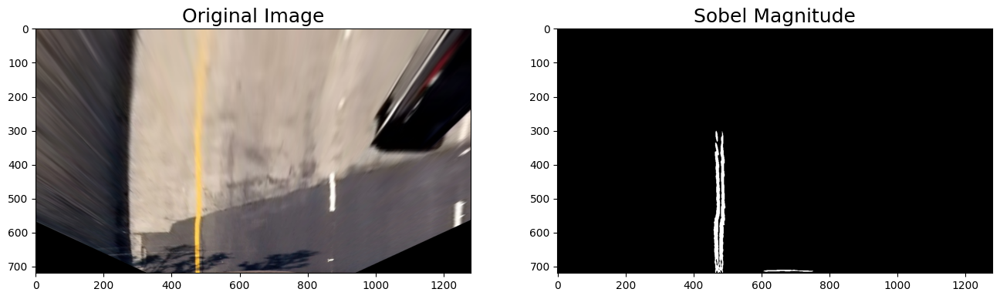

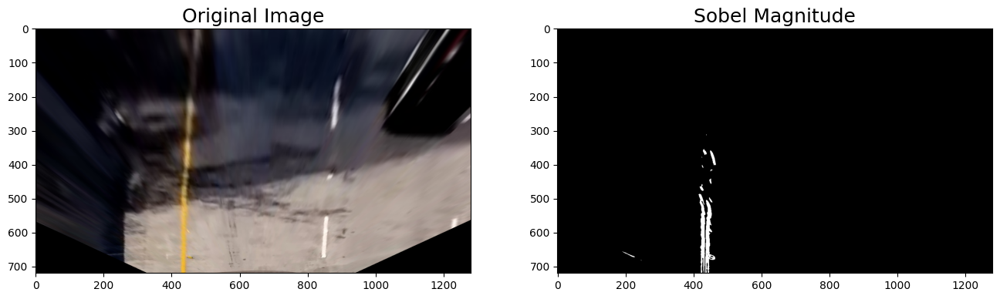

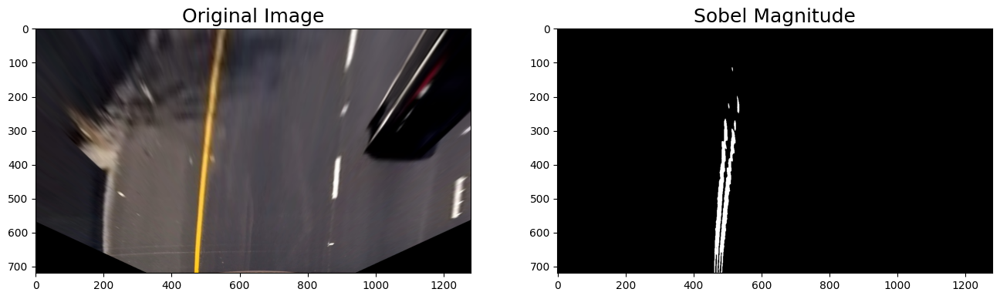

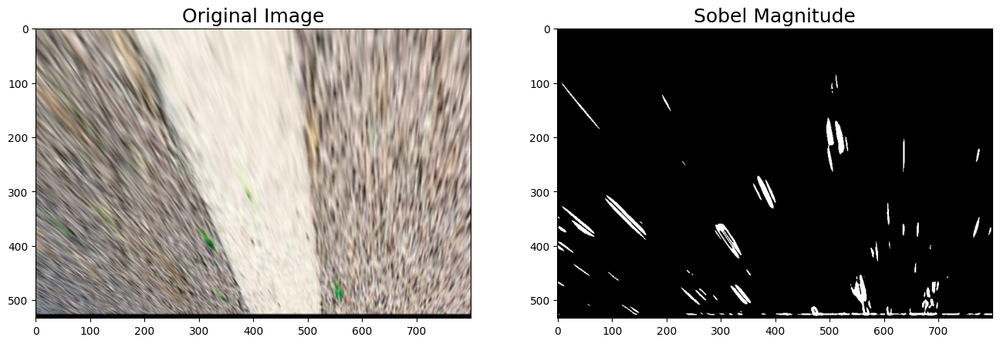

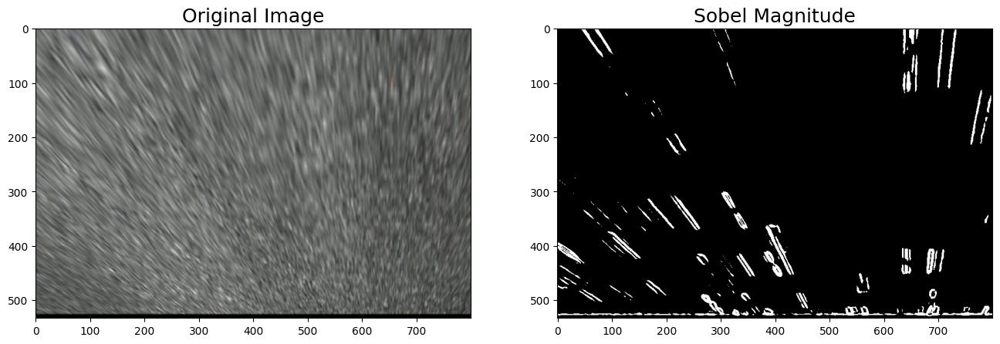

In [29]:
for i, warped_img in enumerate(warped_images):
    # Extract LAB B color channel
    temp,temp1,gray = extract_lab_channels(warped_img)
    # Appy and visualize 
    apply_gradient_magnitude_visualization(warped_img,gray,sobel_kernel,sobel_min_threshold, sobel_max_threshold)


In [30]:
def directional_threshold(grayscale_image, kernel_size=3, threshold=(0, np.pi/2)):
    """
    Applies directional thresholding to a grayscale image using a Sobel kernel.
    
    :param grayscale_image: Grayscale image
    :param kernel_size: Sobel kernel size
    :param threshold: Minimum and maximum threshold values for direction
    :return: Binary image based on the thresholding
    """
    # Calculate the Sobel x and y gradients
    sobel_gradient_x = cv2.Sobel(grayscale_image, cv2.CV_64F, 1, 0, ksize=kernel_size)
    sobel_gradient_y = cv2.Sobel(grayscale_image, cv2.CV_64F, 0, 1, ksize=kernel_size)
    
    # Calculate the absolute value of the gradient direction
    absolute_gradient_direction = np.arctan2(np.absolute(sobel_gradient_y), np.absolute(sobel_gradient_x))
    
    # Initialize binary output as ones
    binary_output_image = np.ones_like(absolute_gradient_direction)
    
    # Apply threshold to get binary output
    binary_output_image[(absolute_gradient_direction >= threshold[0]) & (absolute_gradient_direction <= threshold[1])] = 0
    
    return binary_output_image


In [31]:
def apply_gradient_direction_visualization(original_image, grayscale_image, kernel_size=3, min_threshold=0, max_threshold=np.pi/2):
    """
    A utility function to visualize Sobel direction images.
    
    :param original_image: Unwarped image
    :param grayscale_image: Grayscale version of the input image
    :param kernel_size: Size of the Sobel kernel matrix
    :param min_threshold: Minimum threshold for Sobel direction
    :param max_threshold: Maximum threshold for Sobel direction
    """
    sobel_direction = directional_threshold(grayscale_image, kernel_size, (min_threshold, max_threshold))
    
    fig, (axis1, axis2) = plt.subplots(1, 2, figsize=(16, 16))
    axis1.imshow(original_image)
    axis1.set_title('Original Image', fontsize=18)
    
    axis2.imshow(sobel_direction, cmap='gray')
    axis2.set_title('Sobel Direction', fontsize=18)


In [32]:
# Parameters for sobel direction
dir_min_thresh=0.3
dir_max_thresh=1.51
dir_sobel_kernel = 15

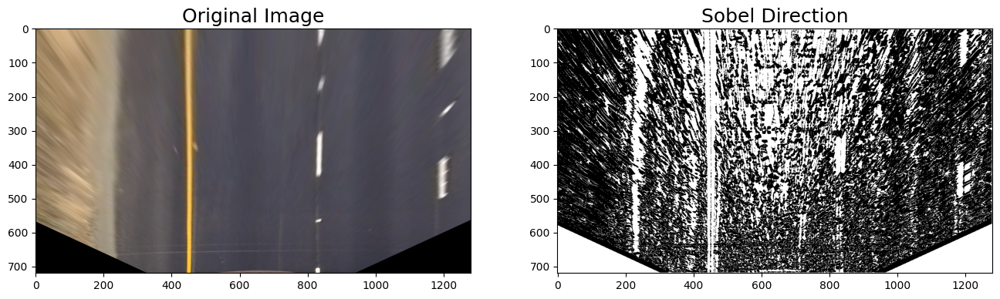

In [33]:
#Display sobel direction for the first unwarped image
unwarped_img = warped_images[0]
# Extract HSL S color channel
_,gray,_ = get_hls_channels(unwarped_img)
# Apply sobel direction threshold and visualize
apply_gradient_direction_visualization(unwarped_img,gray,dir_sobel_kernel,dir_min_thresh,dir_max_thresh )

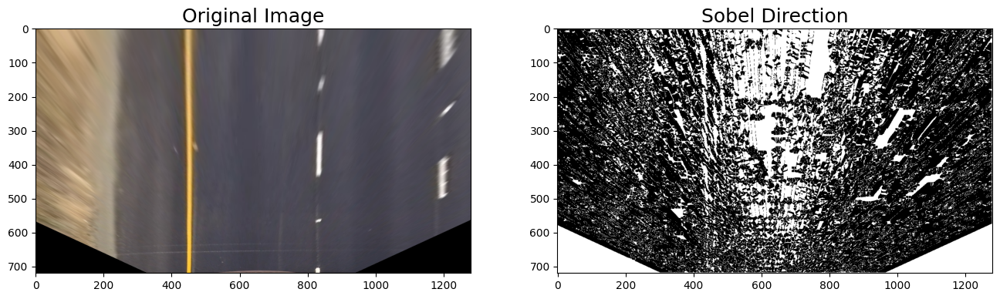

In [34]:
#Display sobel direction for the first unwarped image
unwarped_img = warped_images[0]
# Extract LAB -B  color channel
_,gray,_ = extract_lab_channels(unwarped_img)
# Apply sobel direction threshold and visualize
apply_gradient_direction_visualization(unwarped_img,gray,dir_sobel_kernel,dir_min_thresh,dir_max_thresh )

In [35]:
def combine_gradient_thresholds(unwarped_image, grayscale_image, magnitude_kernel, magnitude_threshold, direction_threshold, direction_kernel):
    """
    This function combines Sobel magnitude and Sobel direction gradients.
    """
    gradient_x = sobel_absolute_threshold(grayscale_image, x_direction=True, minimum_threshold=magnitude_threshold[0], maximum_threshold=magnitude_threshold[1])
    gradient_y = sobel_absolute_threshold(grayscale_image, x_direction=False, minimum_threshold=magnitude_threshold[0], maximum_threshold=magnitude_threshold[1])
    
    magnitude_binary = gradient_magnitude_threshold(grayscale_image, kernel_size=magnitude_kernel, magnitude_threshold=magnitude_threshold)
    
    direction_binary = directional_threshold(grayscale_image, kernel_size=direction_kernel, threshold=direction_threshold)
    
    combined_output = np.zeros_like(direction_binary)
    combined_output[((gradient_x == 1) & (gradient_y == 1)) | ((magnitude_binary == 1) & (direction_binary == 1))] = 1
    
    # A combined binary image
    return combined_output


In [36]:
def visualize_combined_images(original_image, grayscale_image, magnitude_kernel, magnitude_threshold, direction_threshold, direction_kernel):
    combined_gradients = combine_gradient_thresholds(original_image, grayscale_image, magnitude_kernel, magnitude_threshold, direction_threshold, direction_kernel)
    fig, (axis1, axis2) = plt.subplots(1, 2, figsize=(16, 16))
    
    axis1.imshow(original_image)
    axis1.set_title('Original Image', fontsize=18)
    
    axis2.imshow(combined_gradients, cmap='gray')
    axis2.set_title('Sobel Magnitude + Direction', fontsize=18)


In [37]:
dir_thresh = (dir_min_thresh,dir_max_thresh)
mag_thresh = (sobel_min_threshold, sobel_max_threshold)

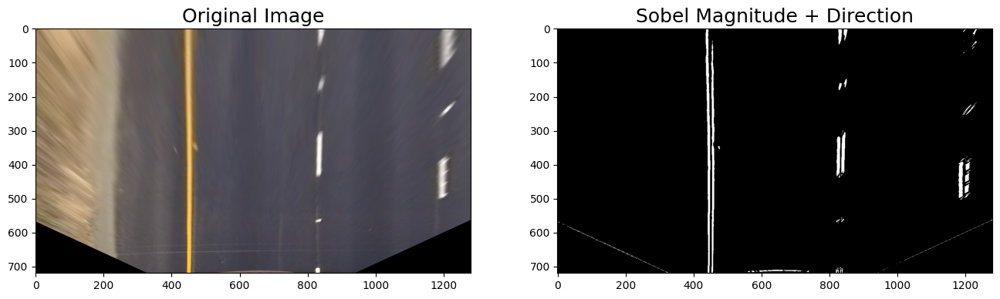

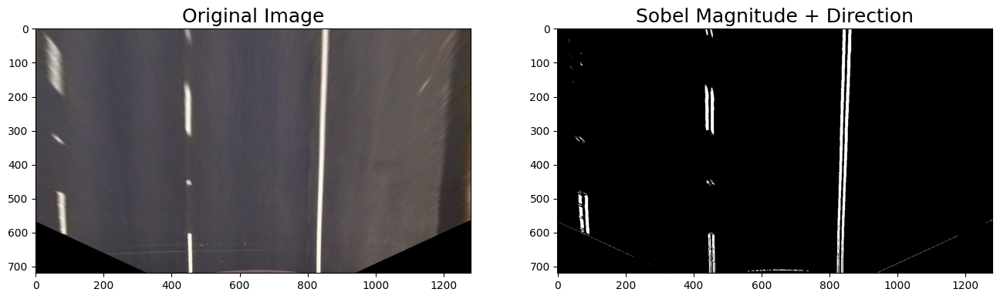

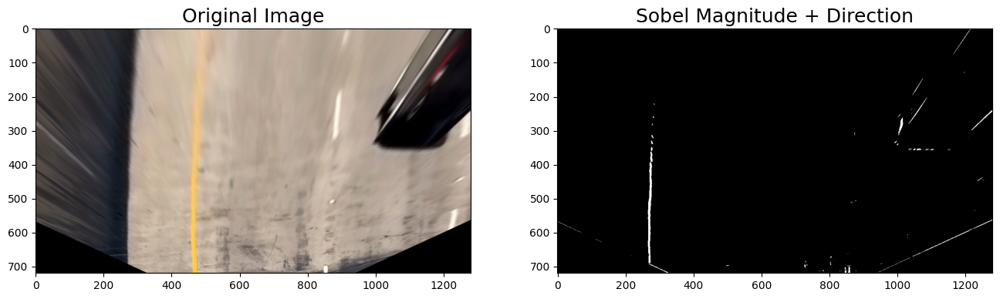

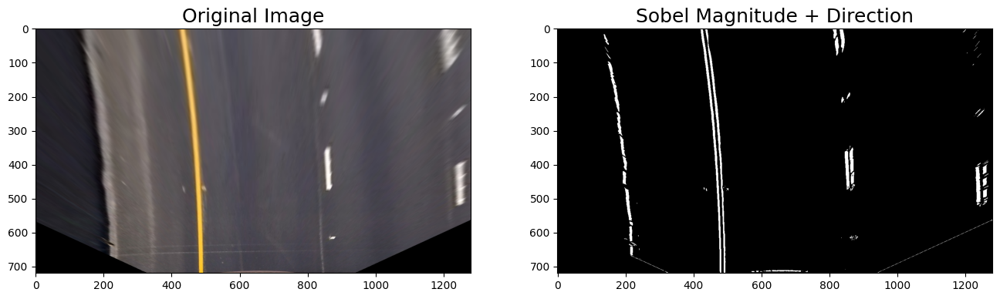

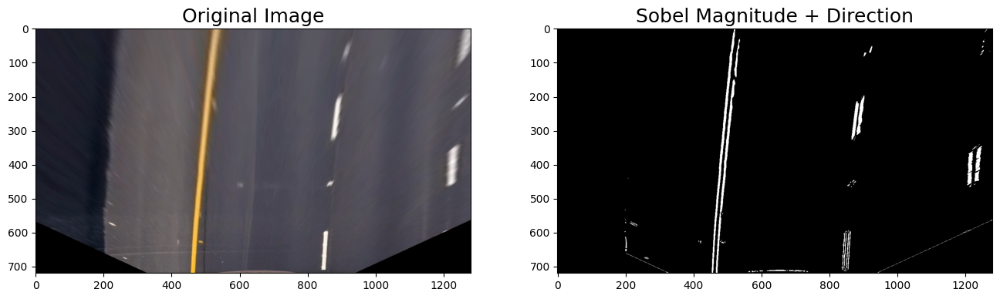

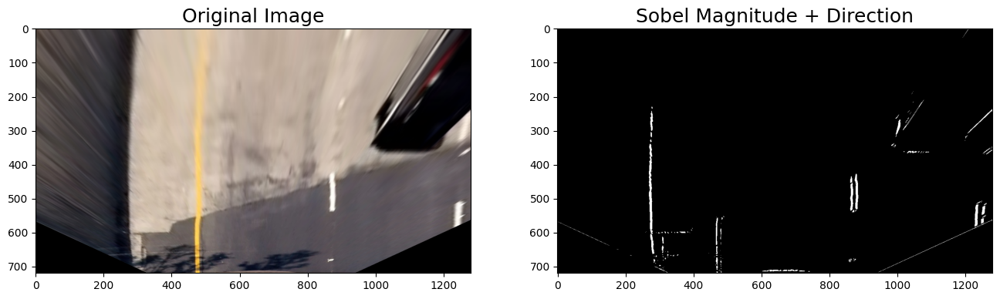

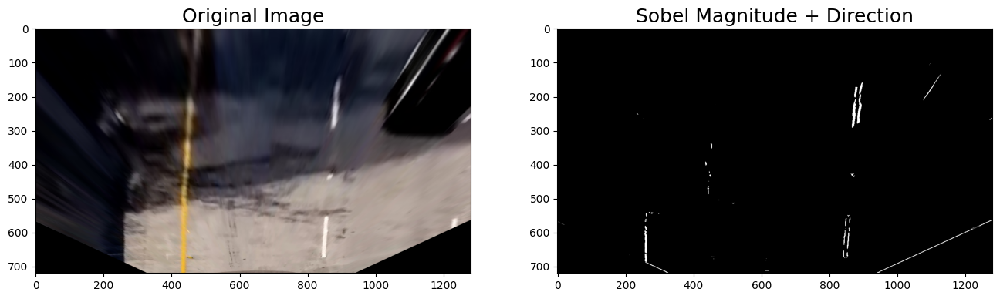

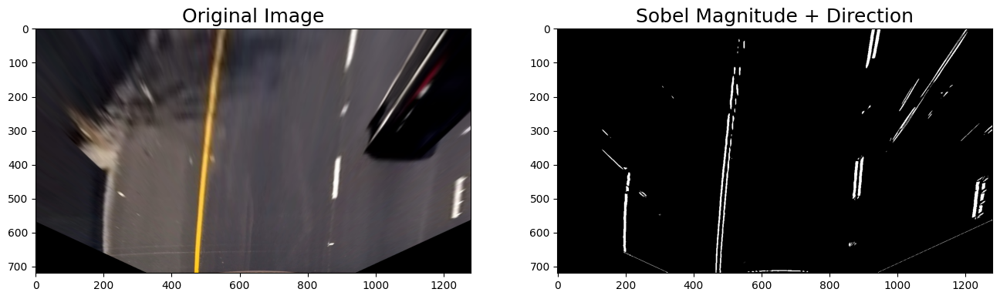

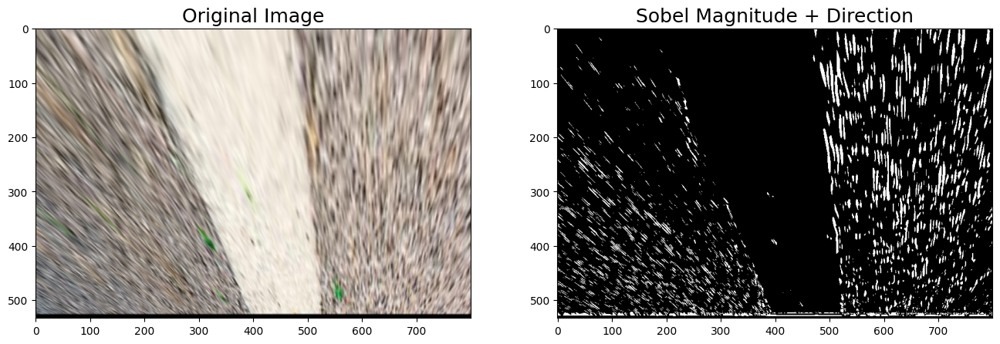

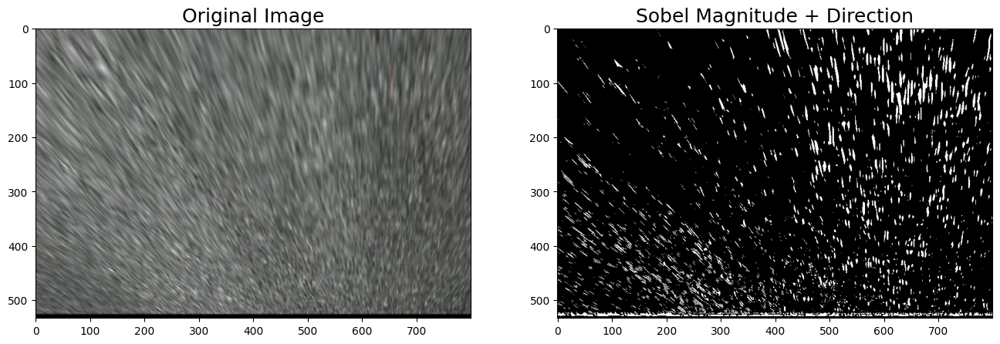

In [38]:
for unwarped_img in warped_images:
    _,gray,_ = get_hls_channels(unwarped_img)
    # Appy and visualize 
    visualize_combined_images(unwarped_img,gray,sobel_kernel,mag_thresh,dir_thresh,dir_sobel_kernel )


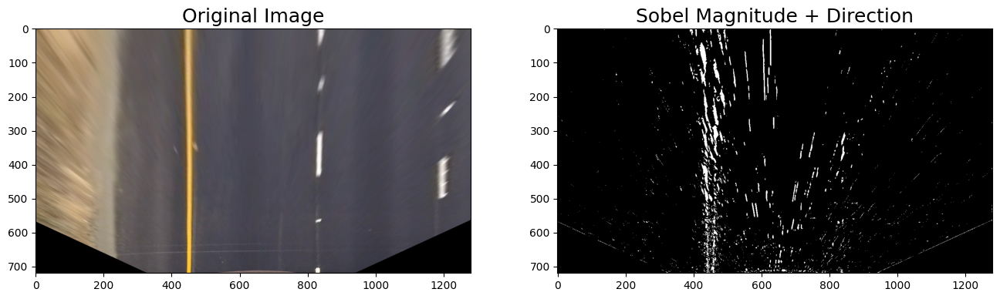

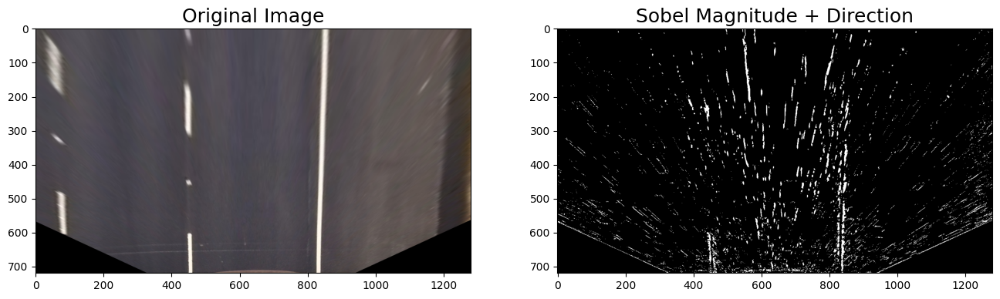

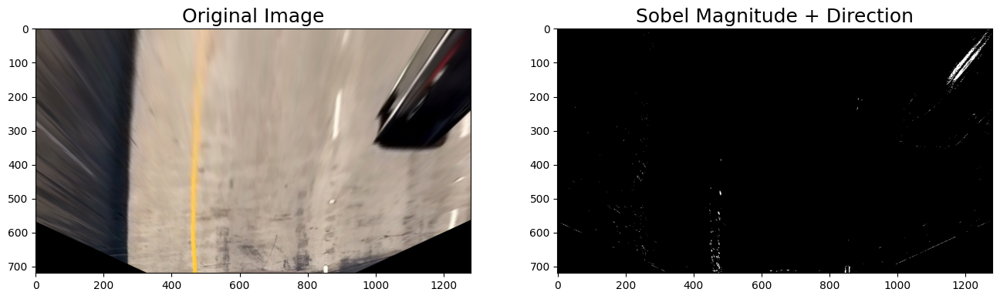

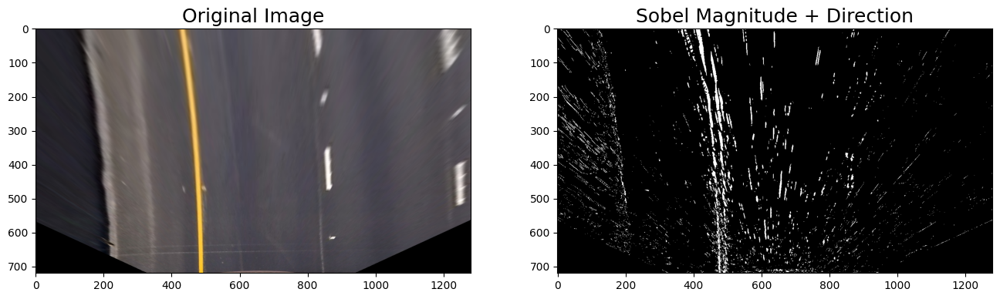

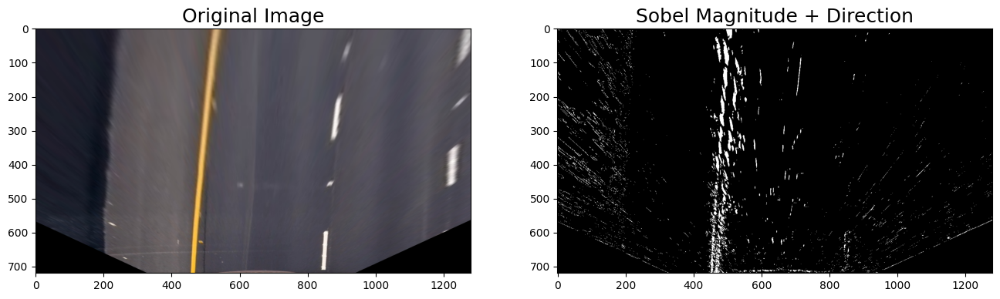

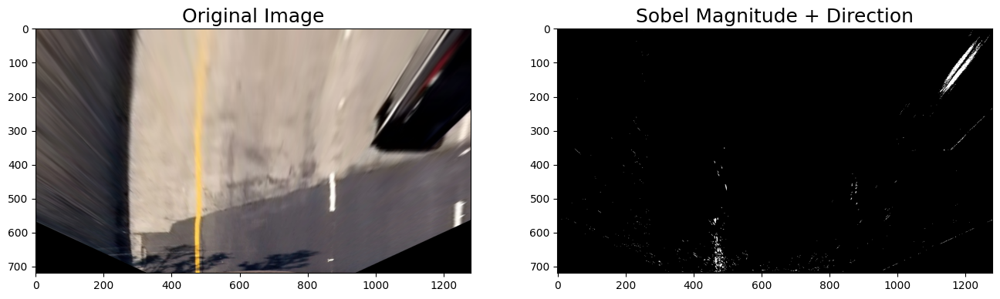

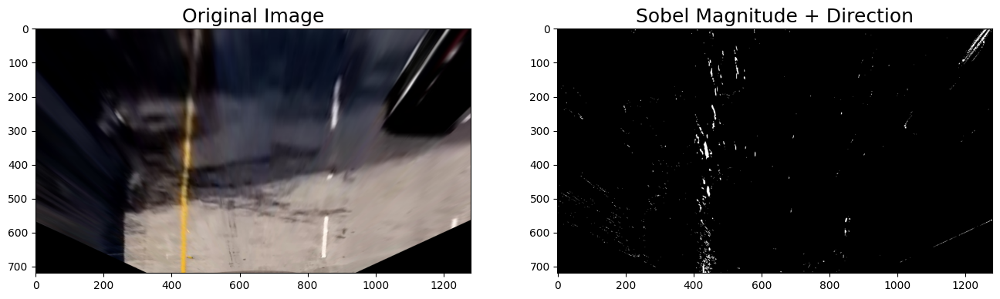

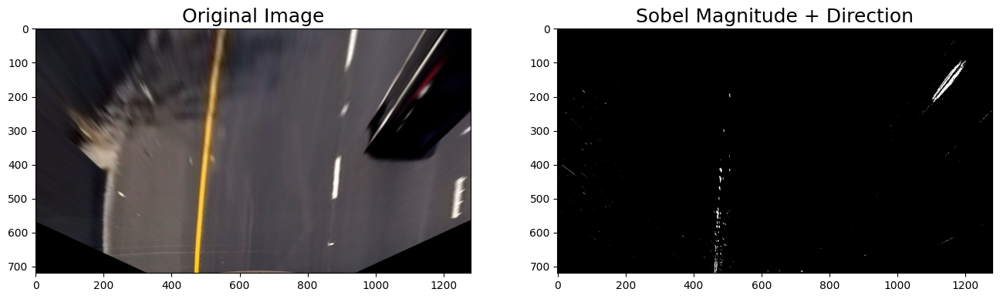

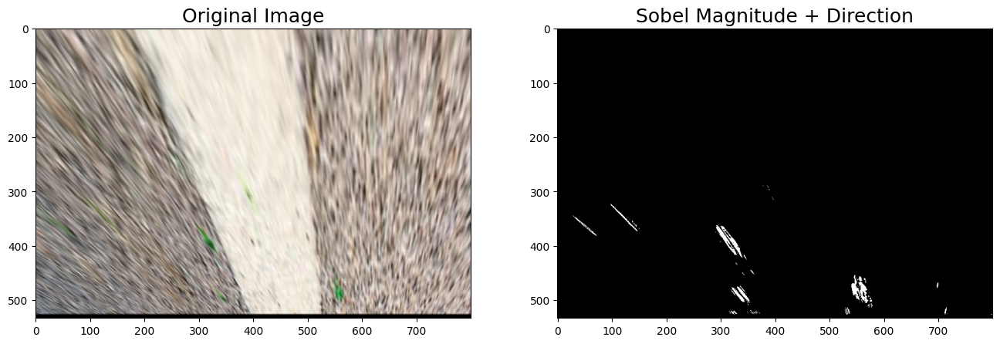

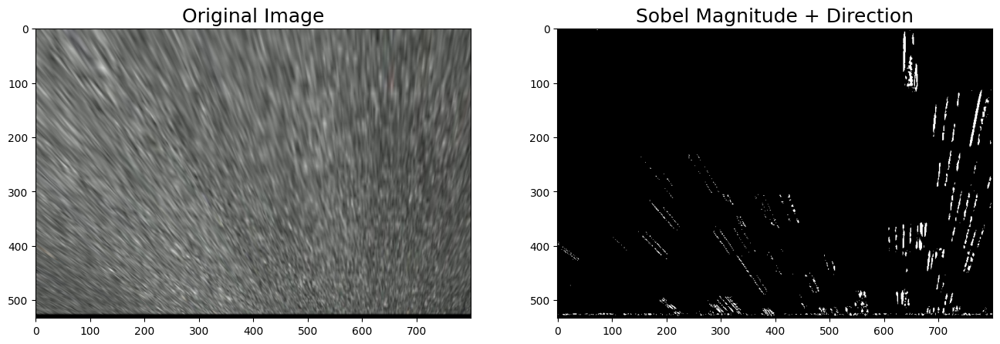

In [39]:
for unwarped_img in warped_images:
    # Etract HSL S color channel
    _,gray,_ = extract_lab_channels(unwarped_img)
    # Appy and visualize 
    visualize_combined_images(unwarped_img,gray,sobel_kernel,mag_thresh,dir_thresh,dir_sobel_kernel )

In [40]:
def normalize_hls_l_channel(input_image, threshold=(220, 255)):
    """
    Normalize the HLS L color channel of an image and return a binary thresholded image.
    
    :param input_image: Input image in RGB color space
    :param threshold: Threshold values as a tuple (lower_bound, upper_bound)
    :return: Binary thresholded image
    """
    #Convert image to HLS color space
    H_channel,hls_l_channel,L_channel =get_hls_channels(input_image)
    
    # Normalize the HLS L channel by scaling it to 0-255 range
    hls_l_channel=hls_l_channel * (255 / np.max(hls_l_channel))
    
    #Apply a threshold to the L channel using the specified lower and upper bounds
    
    binary_output =np.zeros_like(hls_l_channel)
    binary_output[(hls_l_channel > threshold[0]) & (hls_l_channel <= threshold[1])]= 1
    
    #Return a binary image of threshold result
    return binary_output



Text(0.5, 1.0, 'HLS L Color Channel')

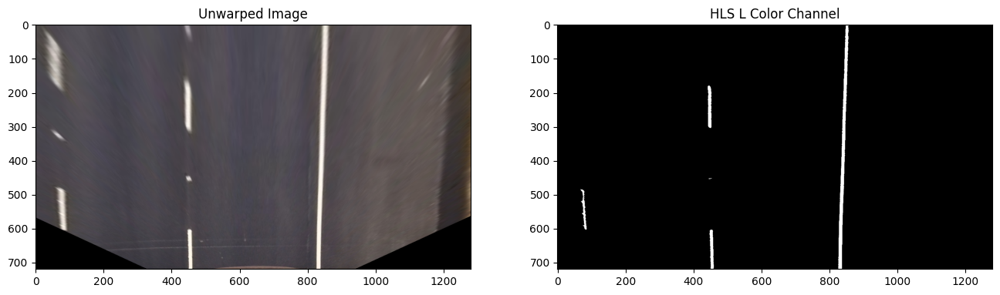

In [41]:
chessboard_sample = warped_images[1]
hls_l_normalized = normalize_hls_l_channel(chessboard_sample)

fig, (axis1, axis2) = plt.subplots(1, 2, figsize=(16, 16))
axis1.imshow(chessboard_sample)
axis1.set_title('Unwarped Image', fontsize=12)
axis2.imshow(hls_l_normalized, cmap='gray')
axis2.set_title('HLS L Color Channel', fontsize=12)


In [42]:
def apply_lab_b_normalization(rgb_image, threshold_values=(190, 255)):
    """
    Normalize the LAB B color channel of the input image and return a binary thresholded image.
    
    :param rgb_image: Input image in RGB color space
    :param threshold_values: Threshold values as a tuple (lower_bound, upper_bound)
    :return: Binary thresholded image
    """
    # 1) Extract the LAB B channel from the RGB image
    _, _, lab_b_ch = extract_lab_channels(rgb_image)
    
    # Check for any yellow pixels in the image before normalizing
    if np.max(lab_b_ch) > 175:
        # Normalize the LAB B channel by scaling it to 0-255 range
        lab_b_ch = lab_b_ch * (255 / np.max(lab_b_ch))
    
    # 2) Apply a threshold to the LAB B channel using the given lower and upper bounds
    binary_img = np.zeros_like(lab_b_ch)
    binary_img[((lab_b_ch > threshold_values[0]) & (lab_b_ch <= threshold_values[1]))] = 1
    
    # 3) Return a binary image of the threshold result
    return binary_img


Text(0.5, 1.0, 'Binary Thresholded LAB B Channel')

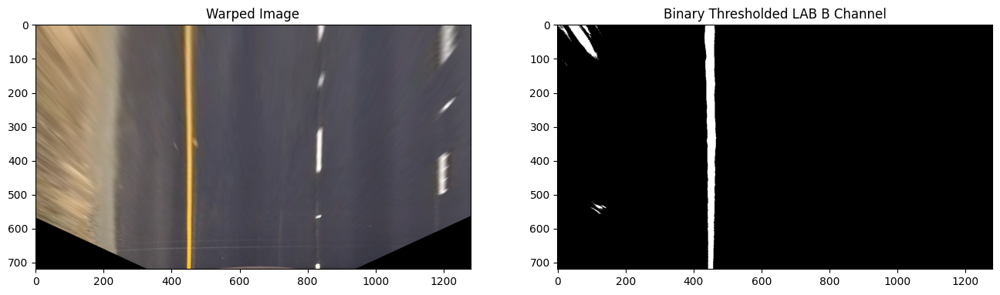

In [43]:
# Choose a sample image from the list of warped images
selected_warped_img = warped_images[0]

# Apply LAB B channel normalization to the selected image
binary_lab_b_ch = apply_lab_b_normalization(selected_warped_img)

# Create a figure with two subplots to display the warped image and the binary thresholded LAB B channel
fig, (warped_ax, bin_ax) = plt.subplots(1, 2, figsize=(16, 16))

# Display the warped image in the first subplot
warped_ax.imshow(selected_warped_img)
warped_ax.set_title('Warped Image', fontsize=12)

# Display the binary thresholded LAB B channel in the second subplot
bin_ax.imshow(binary_lab_b_ch, cmap='gray')
bin_ax.set_title('Binary Thresholded LAB B Channel', fontsize=12)


In [44]:
def process_pipeline(input_image):
    
    # Undistort images
    corrected_image = correct_distortion(input_image)
    
    # Perspective transform
    unwarped_image, transformation_matrix, inverse_matrix = apply_perspective_transform(corrected_image,src,dst)
    
    # HLS L-channel Threshold (using default parameters)
    hls_l_normalized = normalize_hls_l_channel(unwarped_image)

    # Lab B-channel Threshold (using default parameters)
    lab_b_normalized = apply_lab_b_normalization(unwarped_image)
    
    # Combine HLS and Lab B channel thresholds
    merged_thresholds = np.zeros_like(lab_b_normalized)
    merged_thresholds[(hls_l_normalized == 1) | (lab_b_normalized == 1)] = 1
    
    return merged_thresholds, inverse_matrix


Text(0.5, 1.0, 'Binary Thresholded Image')

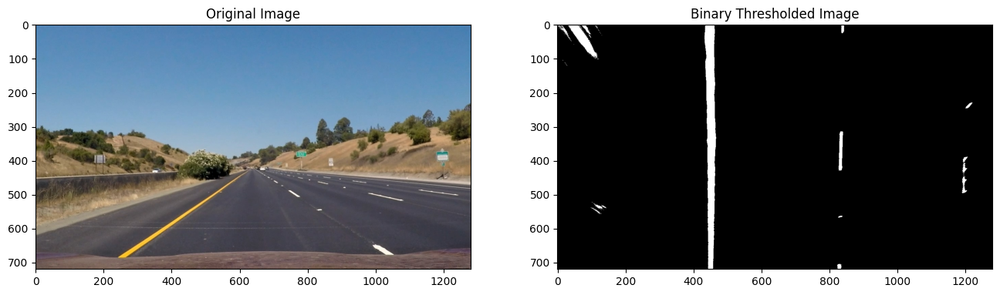

In [45]:
# Get a list of all image file paths in the 'test_images' directory
image_paths = glob.glob('./test_images/*.jpg')

# Read the first image from the list and convert it to the RGB color space
example_image = mpimg.imread(image_paths[0])

# Apply the process_pipeline to the example image to get the combined binary image and minimum pixel value
merged_binary_image, min_pixel_value = process_pipeline(example_image)

# Create a figure with two subplots to display the original image and the binary thresholded image
figure, (original_axis, binary_axis) = plt.subplots(1, 2, figsize=(16, 16))

# Display the original image in the first subplot
original_axis.imshow(example_image)
original_axis.set_title('Original Image', fontsize=12)

# Display the binary thresholded image in the second subplot
binary_axis.imshow(merged_binary_image, cmap='gray')
binary_axis.set_title('Binary Thresholded Image', fontsize=12)


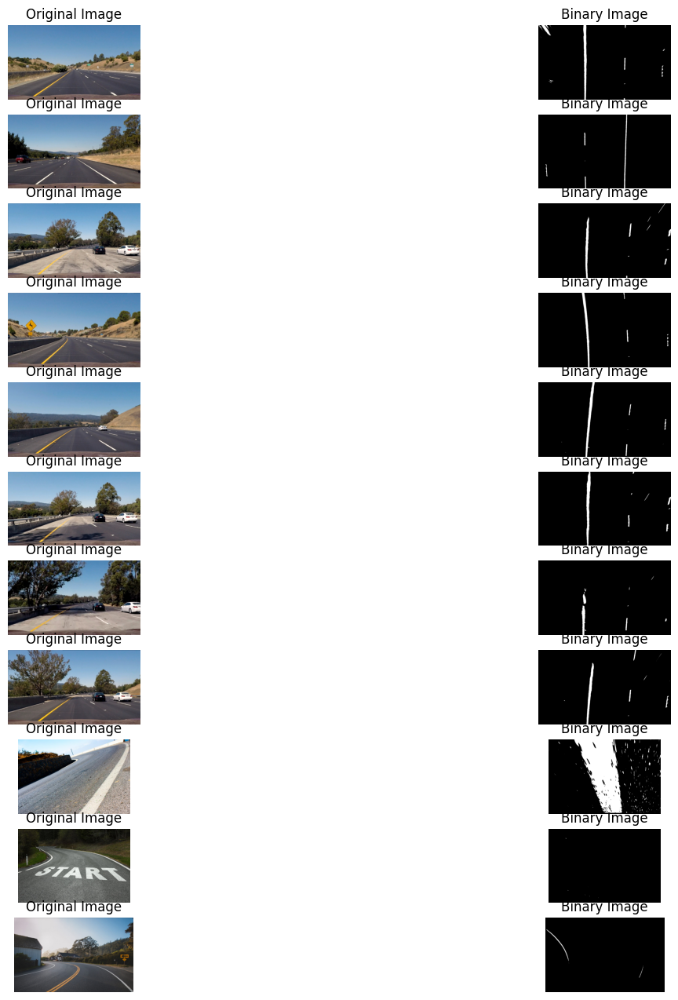

In [46]:

image_list = glob.glob('./test_images/*.jpg')
figure, axes = plt.subplots(len(image_list), 2, figsize=(16, 16))
axes = axes.ravel()
                  
index = 0
for image_path in image_list:
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    binary_image, min_pixel_value = process_pipeline(image)
    axes[index].imshow(image)
    axes[index].axis('off')
    axes[index].set_title("Original Image", fontsize=12)
    index += 1
    axes[index].imshow(binary_image, cmap='gray')
    axes[index].axis('off')
    axes[index].set_title("Binary Image", fontsize=12)
    index += 1


In [47]:
def fit_polynomial_with_sliding_window(binary_image):
    """
    Fits a polynomial to the lane lines in a binary image using the sliding window approach.

    :param binary_image: Unwarped binary image
    """
    # Calculate the histogram of the bottom half of the binary image
    hist = np.sum(binary_image[binary_image.shape[0] // 2:, :], axis=0)
    midpoint = np.int32(hist.shape[0] // 2)
    quarter_point = np.int32(midpoint // 2)
    left_peak = np.argmax(hist[quarter_point:midpoint]) + quarter_point
    right_peak = np.argmax(hist[midpoint:(midpoint + quarter_point)]) + midpoint
    num_windows = 10
    win_height = np.int32(binary_image.shape[0] / num_windows)
    non_zero_pixels = binary_image.nonzero()
    non_zero_y_coords = np.array(non_zero_pixels[0])
    non_zero_x_coords = np.array(non_zero_pixels[1])
    left_pos = left_peak
    right_pos = right_peak
    win_margin = 80
    min_pixels = 40
    left_lane_pixel_indices = []
    right_lane_pixel_indices = []
    rect_data_list = []

    for window in range(num_windows):
        y_low = binary_image.shape[0] - (window + 1) * win_height
        y_high = binary_image.shape[0] - window * win_height
        xleft_low=left_pos - win_margin
        xleft_high=left_pos + win_margin
        xright_low=right_pos - win_margin
        xright_high=right_pos + win_margin
        rect_data_list.append((y_low, y_high, xleft_low, xleft_high, xright_low, xright_high))

        correct_l_indices = ((non_zero_y_coords >= y_low) & (non_zero_y_coords < y_high) &
                             (non_zero_x_coords >= xleft_low) & (non_zero_x_coords < xleft_high)).nonzero()[0]
        correct_r_indices = ((non_zero_y_coords >= y_low) & (non_zero_y_coords < y_high) &
                              (non_zero_x_coords >= xright_low) & (non_zero_x_coords < xright_high)).nonzero()[0]

        left_lane_pixel_indices.append(correct_l_indices)
        right_lane_pixel_indices.append(correct_r_indices)

        if len(correct_l_indices) > min_pixels:
            left_pos = np.int32(np.mean(non_zero_x_coords[correct_l_indices]))
        if len(correct_r_indices) > min_pixels:
            right_pos = np.int32(np.mean(non_zero_x_coords[correct_r_indices]))

    left_lane_pixel_indices = np.concatenate(left_lane_pixel_indices)
    right_lane_pixel_indices = np.concatenate(right_lane_pixel_indices)

    left_x_pos = non_zero_x_coords[left_lane_pixel_indices]
    left_y_pos = non_zero_y_coords[left_lane_pixel_indices]
    right_x_pos = non_zero_x_coords[right_lane_pixel_indices]
    right_y_pos = non_zero_y_coords[right_lane_pixel_indices]

    left_fit, right_fit = (None, None)
    if len(left_x_pos) != 0:
        left_fit = np.polyfit(left_y_pos, left_x_pos, 2)
    if len(right_x_pos) != 0:
        right_fit = np.polyfit(right_y_pos, right_x_pos, 2)

    visualization_data = (rect_data_list, hist)

    return left_fit, right_fit, left_lane_pixel_indices, right_lane_pixel_indices, visualization_data



In [48]:
def display_windows_on_image(input_image):
    """
    A utility function to display split windows on the image.
    
    :param input_image: Original road line image
    """

    binary_img, inverse_transform = process_pipeline(input_image)
    
    left_coeff, right_coeff, left_lane_indices, right_lane_indices, vis_elements = fit_polynomial_with_sliding_window(binary_img)

    image_height = input_image.shape[0]
    left_x_intercept = left_coeff[0] * image_height ** 2 + left_coeff[1] * image_height + left_coeff[2]
    right_x_intercept = right_coeff[0] * image_height ** 2 + right_coeff[1] * image_height + right_coeff[2]

    window_rects = vis_elements[0]
    histogram_data = vis_elements[1]

    # Create an output image to draw and visualize the result
    result_img = np.uint8(np.dstack((binary_img, binary_img, binary_img)) * 255)
    # Generate x and y values for plotting
    y_points = np.linspace(0, binary_img.shape[0] - 1, binary_img.shape[0])
    left_x_points = left_coeff[0] * y_points ** 2 + left_coeff[1] * y_points + left_coeff[2]
    right_x_points = right_coeff[0] * y_points ** 2 + right_coeff[1] * y_points + right_coeff[2]
    
    for rect in window_rects:
        # Draw the windows on the visualization image
        cv2.rectangle(result_img, (rect[2], rect[0]), (rect[3], rect[1]), (0, 255, 0), 2) 
        cv2.rectangle(result_img, (rect[4], rect[0]), (rect[5], rect[1]), (0, 255, 0), 2) 
    
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero_pixels = binary_img.nonzero()
    nonzero_y = np.array(nonzero_pixels[0])
    nonzero_x = np.array(nonzero_pixels[1])
    
    result_img[nonzero_y[left_lane_indices], nonzero_x[left_lane_indices]] = [255, 0, 0]
    result_img[nonzero_y[right_lane_indices], nonzero_x[right_lane_indices]] = [100, 200, 255]

    plt.imshow(result_img)
    plt.plot(left_x_points, y_points, color='yellow')
    plt.plot(right_x_points, y_points, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    # Display the result
    plt.show()


Image after drawing sliding window


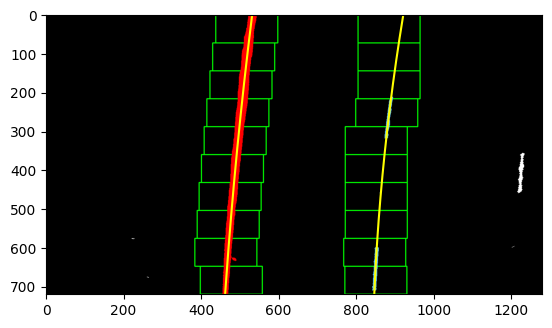

In [49]:
# visualize the result on example image
images = glob.glob('./test_images/*.jpg')
img = cv2.imread(images[4])
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
print("Image after drawing sliding window")
display_windows_on_image(img)
    

In [50]:
def refine_poly_with_prior(processed_img, prior_l_fit, prior_r_fit):
    """
    Refines a second-order polynomial function that was used in the previous
    sliding window approach.

    :param processed_img: A binary warped image (processed image)
    :param prior_l_fit: previous left lane line polynomial points
    :param prior_r_fit: previous right lane line polynomial points
    """
    non_empty_points = processed_img.nonzero()
    non_empty_y = np.array(non_empty_points[0])
    non_empty_x = np.array(non_empty_points[1])
    search_margin = 80
    l_lane_pixels = (
        (non_empty_x > (prior_l_fit[0] * (non_empty_y ** 2) + prior_l_fit[1] * non_empty_y + prior_l_fit[2] - search_margin)) &
        (non_empty_x < (prior_l_fit[0] * (non_empty_y ** 2) + prior_l_fit[1] * non_empty_y + prior_l_fit[2] + search_margin))
    )
    r_lane_pixels = (
        (non_empty_x > (prior_r_fit[0] * (non_empty_y ** 2) + prior_r_fit[1] * non_empty_y + prior_r_fit[2] - search_margin)) &
        (non_empty_x < (prior_r_fit[0] * (non_empty_y ** 2) + prior_r_fit[1] * non_empty_y + prior_r_fit[2] + search_margin))
    )

    # Extract left and right line pixel positions
    l_x_points = non_empty_x[l_lane_pixels]
    l_y_points = non_empty_y[l_lane_pixels]
    r_x_points = non_empty_x[r_lane_pixels]
    r_y_points = non_empty_y[r_lane_pixels]

    updated_l_fit, updated_r_fit = (None, None)
    if len(l_x_points) != 0:
        # Fit a second-order polynomial to each
        updated_l_fit = np.polyfit(l_y_points, l_x_points, 2)
    if len(r_x_points) != 0:
        updated_r_fit = np.polyfit(r_y_points, r_x_points, 2)

    return updated_l_fit, updated_r_fit, l_lane_pixels, r_lane_pixels


In [51]:
def draw_polygon_on_image(raw_img):
    """
    :param raw_img: Raw test image
    """
    binary_img, inverse_mtx = process_pipeline(raw_img)
    initial_l_poly, initial_r_poly, init_l_indices, init_r_indices, vis_elems = fit_polynomial_with_sliding_window(binary_img)
    
    refined_l_poly, refined_r_poly, updated_l_indices, updated_r_indices = refine_poly_with_prior(binary_img, initial_l_poly, initial_r_poly)

    # Generate x and y values for plotting
    y_values = np.linspace(0, binary_img.shape[0]-1, binary_img.shape[0])
    initial_r_x= initial_r_poly[0]*y_values**2+initial_r_poly[1]*y_values + initial_r_poly[2]
    initial_l_x =initial_l_poly[0]*y_values**2+initial_l_poly[1]*y_values + initial_l_poly[2]
    refined_r_x= refined_r_poly[0]*y_values**2+refined_r_poly[1]*y_values + refined_r_poly[2]
    refined_l_x =refined_l_poly[0]*y_values**2+refined_l_poly[1]*y_values + refined_l_poly[2]
    

    # Create an image to draw on and an image to show the selection window
    output_img = np.uint8(np.dstack((binary_img, binary_img, binary_img))*255)
    window_img = np.zeros_like(output_img)
    non_empty_pts = binary_img.nonzero()
    non_empty_y = np.array(non_empty_pts[0])
    non_empty_x = np.array(non_empty_pts[1])
    output_img[non_empty_y[updated_l_indices], non_empty_x[updated_l_indices]] = [0, 255, 0]
    output_img[non_empty_y[updated_r_indices], non_empty_x[updated_r_indices]] = [255, 0, 0]
    
    margin_val = 80
    # Generate a polygon to illustrate the search window area
    l_poly_1 = np.array([np.transpose(np.vstack([initial_l_x - margin_val, y_values]))])
    l_poly_2 = np.array([np.flipud(np.transpose(np.vstack([initial_l_x + margin_val, y_values])))])
    l_points = np.hstack((l_poly_1, l_poly_2))
    r_poly_1 = np.array([np.transpose(np.vstack([initial_r_x - margin_val, y_values]))])
    r_poly_2 = np.array([np.flipud(np.transpose(np.vstack([initial_r_x + margin_val, y_values])))])
    r_points = np.hstack((r_poly_1, r_poly_2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([l_points]), (0, 255, 0))
    cv2.fillPoly(window_img, np.int_([r_points]), (0, 255, 0))
    result_img = cv2.addWeighted(output_img, 1, window_img, 0.3, 0)
    plt.imshow(result_img)
    plt.plot(refined_l_x, y_values, color='yellow')
    plt.plot(refined_r_x, y_values, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)


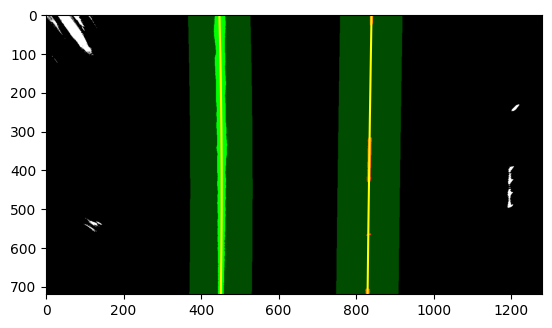

In [52]:

images= glob.glob('./test_images/*.jpg')
img =cv2.imread(images[0])
img= cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
draw_polygon_on_image(img)

In [53]:
def compute_curvature_and_center_distance(binary_img, left_fit_coeff, right_fit_coeff, left_lane_indices, right_lane_indices):
    """
    This function calculates the curvature radius and distance from the center of the lane.
    """
    ym_per_pixel = 3.048/100 
    xm_per_pixel = 3.7/378
    left_curvature_radius, right_curvature_radius, center_distance = (0, 0, 0)
    
    # Define y-value where we want radius of curvature
    # I'll choose the maximum y-value, corresponding to the bottom of the image
    height = binary_img.shape[0]
    plot_y = np.linspace(0, height - 1, height)
    y_eval = np.max(plot_y)
    nonzero_elements = binary_img.nonzero()
    nonzero_y =np.array(nonzero_elements[0])
    nonzero_x= np.array(nonzero_elements[1])
    left_x= nonzero_x[left_lane_indices]
    left_y = nonzero_y[left_lane_indices]
    right_x= nonzero_x[right_lane_indices]
    right_y =nonzero_y[right_lane_indices]

    if len(left_x) != 0 and len(right_x) != 0:
        # Fit new polynomials to x,y in world space
        left_fit_world = np.polyfit(left_y * ym_per_pixel, left_x * xm_per_pixel, 2)
        right_fit_world = np.polyfit(right_y * ym_per_pixel, right_x * xm_per_pixel, 2)
        
        # Calculate the new radii of curvature
        left_curvature_radius = ((1 + (2 * left_fit_world[0] * y_eval * ym_per_pixel + left_fit_world[1]) ** 2) ** 1.5) / np.absolute(2 * left_fit_world[0])
        right_curvature_radius = ((1 + (2 * right_fit_world[0] * y_eval * ym_per_pixel + right_fit_world[1]) ** 2) ** 1.5) / np.absolute(2 * right_fit_world[0])
    
    # Distance from center is image x midpoint - mean of left_fit and right_fit intercepts 
    if right_fit_coeff is not None and left_fit_coeff is not None:
        car_pos = binary_img.shape[1] / 2
        left_fit_x_intercept = left_fit_coeff[0] * height ** 2 + left_fit_coeff[1] * height + left_fit_coeff[2]
        right_fit_x_intercept = right_fit_coeff[0] * height ** 2 + right_fit_coeff[1] * height + right_fit_coeff[2]
        lane_center_pos = (right_fit_x_intercept + left_fit_x_intercept) / 2
        center_distance = (car_pos - lane_center_pos) * xm_per_pixel

    return left_curvature_radius, right_curvature_radius, center_distance


In [54]:
# Calculate sample curve radius and center distance
test_image = cv2.imread('./test_images/test2.jpg')
test_image = cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB)
binary_test_image, inv_transform = process_pipeline(test_image)

init_left_poly, init_right_poly, init_left_lane_indices, init_right_lane_indices, vis_data = fit_polynomial_with_sliding_window(binary_test_image)
left_curve_rad, right_curve_rad, dist_from_center = compute_curvature_and_center_distance(binary_test_image, init_left_poly, init_right_poly, init_left_lane_indices, init_right_lane_indices)

print('Radius of curvature for example:', left_curve_rad, 'm,', right_curve_rad, 'm')
print('Total distance from center of the lane:', dist_from_center, 'm')


Radius of curvature for example: 476.61255328437085 m, 1551.8689630106621 m
Total distance from center of the lane: -0.41266059389904786 m


In [55]:
def render_lane_on_image(original_image):
    """
    This function is used to draw the lane on the road image.
    :param original_image: Original test image
    """
    # Apply image processing pipeline
    proc_img, inv_transform_matrix = process_pipeline(original_image)
    left_poly, right_poly, _, _, _ = fit_polynomial_with_sliding_window(proc_img)

    output_img = np.copy(original_image)
    if left_poly is None or right_poly is None:
        return original_image
    
    # Create an image to draw the lines on
    blank_layer = np.zeros_like(proc_img).astype(np.uint8)
    color_layer = np.dstack((blank_layer, blank_layer, blank_layer))

    img_h, img_w = proc_img.shape
    plot_y_axis = np.linspace(0, img_h - 1, num=img_h)  # to cover the same y-range as the image
    left_fit_x_axis = left_poly[0] * plot_y_axis**2 + left_poly[1] * plot_y_axis + left_poly[2]
    right_fit_x_axis = right_poly[0] * plot_y_axis**2 + right_poly[1] * plot_y_axis + right_poly[2]
    left_lane_pts = np.array([np.transpose(np.vstack([left_fit_x_axis, plot_y_axis]))])
    right_lane_pts = np.array([np.flipud(np.transpose(np.vstack([right_fit_x_axis, plot_y_axis])))])
    lane_pts = np.hstack((left_lane_pts, right_lane_pts))

    # Draw the lane onto the color_layer image
    cv2.fillPoly(color_layer, np.int_([lane_pts]), (255, 0, 0))
    cv2.polylines(color_layer, np.int32([left_lane_pts]), isClosed=False, color=(255, 255, 0), thickness=15)
    cv2.polylines(color_layer, np.int32([right_lane_pts]), isClosed=False, color=(255, 255, 0), thickness=15)

    # Warp the color_layer back to the original image space using the inverse perspective matrix (inv_transform_matrix)
    unwarped_layer = cv2.warpPerspective(color_layer, inv_transform_matrix, (img_w, img_h))
    result = cv2.addWeighted(output_img, 1, unwarped_layer, 0.5, 0)
    return result


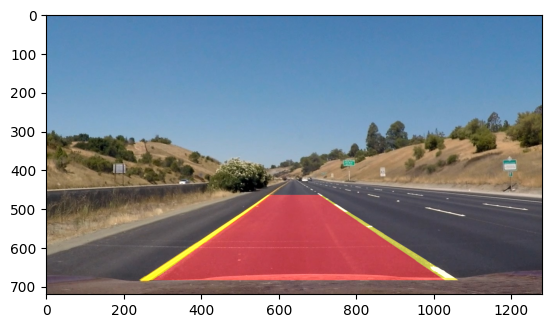

In [56]:
# drawing lane on test image
res = render_lane_on_image(img)
plt.imshow(res)
plt.show()

In [57]:
def display_lane_data(original_image, curvature_rad, lane_ctr_dist):
    """
    This function is used to add curvature radius and lane center distance onto the test image.
    
    :param original_image: Original test image
    :param curvature_rad: Calculated curvature radius for lane lines
    :param lane_ctr_dist: Calculated distance from the lane center
    """
    output_img = np.copy(original_image)
    img_height = output_img.shape[0]
    font_style = cv2.FONT_HERSHEY_DUPLEX
    
    # Define font styles for curvature and distance text
    curvature_font = cv2.FONT_HERSHEY_SIMPLEX
    dist_font = cv2.FONT_HERSHEY_TRIPLEX

    # Add text for curvature radius in red color
    curvature_text = 'Radius of current frame: ' + '{:04.2f}'.format(curvature_rad) + 'm'
    cv2.putText(output_img, curvature_text, (40, 70), curvature_font, 1.5, (0, 0, 255), 2, cv2.LINE_AA)

    # Add text for distance from center in blue color
    direction = ''
    if lane_ctr_dist > 0:
        direction = 'right'
    elif lane_ctr_dist < 0:
        direction = 'left'

    abs_lane_ctr_dist = abs(lane_ctr_dist)
    center_dist_text = '{:04.3f}'.format(abs_lane_ctr_dist) + 'm ' + direction + ' of center'
    cv2.putText(output_img, center_dist_text, (40, 120), dist_font, 1.5, (255, 0, 0), 2, cv2.LINE_AA)
    
    return output_img


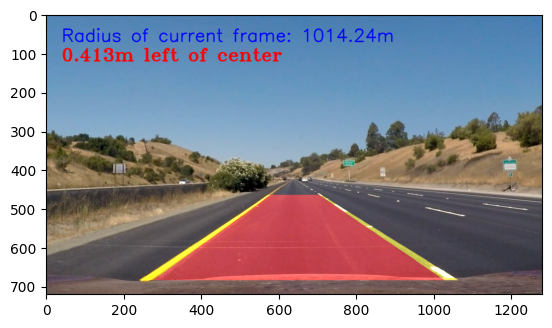

In [58]:
# drawing lane on test image with radius and lane center
output = display_lane_data(res, (left_curve_rad+right_curve_rad)/2, dist_from_center)
plt.imshow(output)
plt.show()

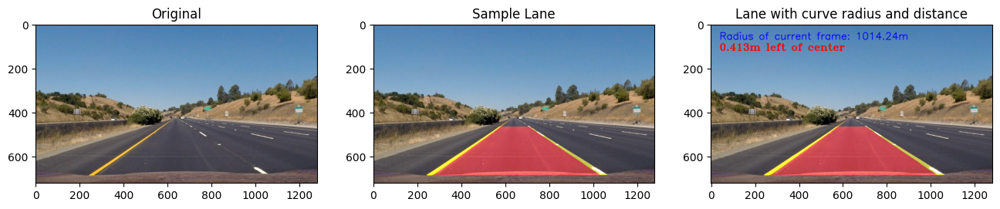

In [59]:
# visualize draw lane final results
fig, axes = plt.subplots(1,3, figsize=(16, 16))
axes[0].imshow(img)
axes[0].set_title('Original')
axes[1].imshow(res)
axes[1].set_title('Sample Lane')
axes[2].imshow(output)
axes[2].set_title('Lane with curve radius and distance')
plt.show()

In [60]:
class LaneLine:
    def __init__(self):
        self.line_detected = False
        self.recent_x_fitted = []
        self.avg_best_x = None
        self.avg_best_fit = None
        self.recent_fit = []
        self.curvature_radius = None
        self.distance_from_center = None
        self.fit_coeff_diffs = np.array([0, 0, 0], dtype='float')
        self.pixel_count = None

    def add_fit(self, fit_coeffs, px_indices):
        if fit_coeffs is not None:
            if self.avg_best_fit is not None:
                self.fit_coeff_diffs = abs(fit_coeffs - self.avg_best_fit)
            if (self.fit_coeff_diffs[0] > 0.001 or
                    self.fit_coeff_diffs[1] > 1.0 or
                    self.fit_coeff_diffs[2] > 100.) and \
                    len(self.recent_fit) > 0:
                self.line_detected = False
            else:
                self.line_detected = True
                self.pixel_count = np.count_nonzero(px_indices)
                self.recent_fit.append(fit_coeffs)
                if len(self.recent_fit) > 5:
                    self.recent_fit = self.recent_fit[len(self.recent_fit) - 5:]
                self.avg_best_fit = np.average(self.recent_fit, axis=0)
        else:
            self.line_detected = False
            if len(self.recent_fit) > 0:
                self.recent_fit = self.recent_fit[:len(self.recent_fit) - 1]
            if len(self.recent_fit) > 0:
                self.avg_best_fit = np.average(self.recent_fit, axis=0)


In [61]:
def process_image(input_img):
    """
    Image processing pipeline used for generating video output.

    :param input_img: Input frame image or any test image
    """

    copied_img = np.copy(input_img)
    binary_img, Minv = process_pipeline(copied_img)

    if not left_lane_line.line_detected or not right_lane_line.line_detected:
        left_fit_coeffs, right_fit_coeffs, left_lane_indices, right_lane_indices, _ = fit_polynomial_with_sliding_window(binary_img)
    else:
        left_fit_coeffs, right_fit_coeffs, left_lane_indices, right_lane_indices = refine_poly_with_prior(binary_img, left_lane_line.avg_best_fit, right_lane_line.avg_best_fit)

    if left_fit_coeffs is not None and right_fit_coeffs is not None:
        image_height = input_img.shape[0]
        left_fit_x_int = left_fit_coeffs[0]*image_height**2 + left_fit_coeffs[1]*image_height + left_fit_coeffs[2]
        right_fit_x_int = right_fit_coeffs[0]*image_height**2 + right_fit_coeffs[1]*image_height + right_fit_coeffs[2]
        x_int_diff = abs(right_fit_x_int - left_fit_x_int)
        if abs(350 - x_int_diff) > 100:
            left_fit_coeffs = None
            right_fit_coeffs = None

    left_lane_line.add_fit(left_fit_coeffs, left_lane_indices)
    right_lane_line.add_fit(right_fit_coeffs, right_lane_indices)

    if left_lane_line.avg_best_fit is not None and right_lane_line.avg_best_fit is not None:
        img_with_lane = render_lane_on_image(copied_img)
        left_rad, right_rad, center_dist = compute_curvature_and_center_distance(binary_img, left_lane_line.avg_best_fit, right_lane_line.avg_best_fit, 
                                                               left_lane_indices, right_lane_indices)
        final_img = display_lane_data(img_with_lane, (left_rad + right_rad) / 2, center_dist)
    else:
        final_img = copied_img

    return final_img


In [62]:
def plot_fit_onto_img(input_img, fit_coeffs, plot_color):
    """
    Plots the fit line onto the input image.
    :param input_img: The input image to plot the fit line on
    :param fit_coeffs: The fit coefficients for the line
    :param plot_color: The color of the plotted line
    """
    if fit_coeffs is None:
        return input_img
    new_img = np.copy(input_img)
    img_height = new_img.shape[0]
    plot_y = np.linspace(0, img_height-1, img_height)
    plot_x = fit_coeffs[0]*plot_y**2 + fit_coeffs[1]*plot_y + fit_coeffs[2]
    points = np.array([np.transpose(np.vstack([plot_x, plot_y]))])
    cv2.polylines(new_img, np.int32([points]), isClosed=False, color=plot_color, thickness=8)
    
    return new_img


In [63]:

from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [64]:
left_lane_line = LaneLine()
right_lane_line = LaneLine()
video_output1 = 'output_videos/videoplayback.mp4'
video_input1 = VideoFileClip('input_videos/videoplayback.mp4')
processed_video = video_input1.fl_image(process_image)

# Define a function to count the number of frames
#def count_frames(frame):
#    global frame_count
#    frame_count += 1
#    return frame

#frame_count = 0
# Loop through the frames and count the number of frames
#for frame in processed_video.iter_frames():
 #   count_frames(frame)

#print("Number of frames in the video: ", frame_count)

%time processed_video.write_videofile(video_output1, audio=False)


Moviepy - Building video output_videos/videoplayback.mp4.
Moviepy - Writing video output_videos/videoplayback.mp4



Moviepy - Done !
Moviepy - video ready output_videos/videoplayback.mp4
Wall time: 4min 18s


In [65]:
# 
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output1))

In [66]:
left_lane_line = LaneLine()
right_lane_line = LaneLine()
video_output2 = 'output_videos/more_curved.mp4'
video_input2 = VideoFileClip('input_videos/more_curved.mp4')
processed_video2 = video_input1.fl_image(process_image)


%time processed_video2.write_videofile(video_output2, audio=False)

Moviepy - Building video output_videos/more_curved.mp4.
Moviepy - Writing video output_videos/more_curved.mp4



Moviepy - Done !
Moviepy - video ready output_videos/more_curved.mp4
Wall time: 4min 5s


In [67]:
# 
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output2))

In [68]:
left_lane_line = LaneLine()
right_lane_line = LaneLine()
video_output3 = 'output_videos/ERB.mp4'
video_input3 = VideoFileClip('input_videos/ERB.mp4')
processed_video3 = video_input3.fl_image(process_image)


%time processed_video3.write_videofile(video_output3, audio=False)

Moviepy - Building video output_videos/ERB.mp4.
Moviepy - Writing video output_videos/ERB.mp4



Moviepy - Done !
Moviepy - video ready output_videos/ERB.mp4
Wall time: 9.63 s


In [69]:
# 
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output3))